In [1]:
import glob
import os
import skimage
import pandas as pd
import cv2
from tensorflow import keras
import numpy as np
import matplotlib.pyplot as plt
from patchify import patchify, unpatchify
import keras.backend as K
from tensorflow.keras.models import load_model
from skan import Skeleton, summarize
from sklearn.cluster import KMeans
from skimage.morphology import skeletonize
from skan import Skeleton, summarize, draw
from skan.csr import skeleton_to_csgraph
import networkx as nx

2025-06-27 04:10:40.547597: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
def f1(y_true, y_pred):
    def recall_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = TP / (Positives+K.epsilon())
        return recall
    
    def precision_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Pred_Positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = TP / (Pred_Positives+K.epsilon())
        return precision
    
    precision, recall = precision_m(y_true, y_pred), recall_m(y_true, y_pred)
    
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

In [3]:
patch_size = 256
example_file_name = '/Volumes/T7/Artificial Intelligence/YEAR 2.1/Block B retake/task5/rayanedaborisova_220471_unet_model_256px.h5'
model = load_model(example_file_name, custom_objects={"f1": f1})
folder_path = '/Volumes/T7/Artificial Intelligence/YEAR 2.1/Block B retake/task8/Kaggle'

In [4]:
def crop(img):
    original_shape = img.shape

    # Convert to grayscale if RGB
    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Blur and threshold to detect contours
    blurred = cv2.GaussianBlur(img, (11, 11), 0)
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return img, {
            "original_shape": original_shape,
            "legend_cropped": False,
            "used_crop": False
        }

    # Crop around largest contour (Petri dish)
    largest = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest)
    size = max(w, h)
    x_center, y_center = x + w // 2, y + h // 2
    x_start = max(0, x_center - size // 2)
    y_start = max(0, y_center - size // 2)

    cropped = img[y_start:y_start + size, x_start:x_start + size]

    crop_info = {
        "original_shape": original_shape,
        "legend_cropped": False,
        "used_crop": True,
        "x_start": x_start,
        "y_start": y_start,
        "crop_size": size
    }

    return cropped, crop_info

In [5]:
def pad(img, patch_size):
    h, w = img.shape[:2]

    height_margin = ((h // patch_size) + 1) * patch_size - h
    width_margin = ((w // patch_size) + 1) * patch_size - w

    top_margin = int(height_margin / 2)
    bottom_margin = height_margin - top_margin
    left_margin = int(width_margin / 2)
    right_margin = width_margin - left_margin

    padded_img = cv2.copyMakeBorder(
        img,
        top_margin, bottom_margin,
        left_margin, right_margin,
        cv2.BORDER_CONSTANT, value=0
    )

    return padded_img, (top_margin, bottom_margin, left_margin, right_margin)

In [6]:
def uncrop(cropped_img, crop_info):
    original_shape = crop_info["original_shape"]
    canvas = np.zeros(original_shape[:2], dtype=cropped_img.dtype)

    if not crop_info.get("used_crop", False):
        return cropped_img

    x_start = crop_info["x_start"]
    y_start = crop_info["y_start"]
    size = crop_info["crop_size"]

    # Paste cropped prediction back into full-sized black canvas
    canvas[y_start:y_start + size, x_start:x_start + size] = cropped_img

    # Legend logic removed (didn't work on .tif), so nothing is padded back
    return canvas

In [7]:
def unpad(img, padding):
    top, bottom, left, right = padding
    return img[top:img.shape[0]-bottom, left:img.shape[1]-right]

In [8]:
def predict_masks(folder_path, model, patch_size=256):
    results = {}

    for filename in sorted(os.listdir(folder_path)):
        if not filename.lower().endswith(('.png', '.jpg', '.jpeg', '.tif', '.tiff')):
            continue

        print(f"\nProcessing {filename}")
        image_path = os.path.join(folder_path, filename)
        image = cv2.imread(image_path, 0)

        h, w = image.shape
        print(f"Original image shape: {h} x {w}")

        # Preprocessing
        petri_dish, crop_info = crop(image)
        print(f"Petri dish image shape: {petri_dish.shape}")

        petri_dish_padded, pad_info = pad(petri_dish, patch_size)
        print(f"Padded image shape: {petri_dish_padded.shape}")

        # Patchify and predict
        patches = patchify(petri_dish_padded, (patch_size, patch_size), step=128)
        patches_shape = patches.shape
        patches_reshaped = patches.reshape(-1, patch_size, patch_size, 1) / 255.0

        predictions = model.predict(patches_reshaped, verbose=1)
        predictions = predictions.squeeze().reshape(patches_shape[0], patches_shape[1], patch_size, patch_size)

        predicted_mask = unpatchify(predictions, petri_dish_padded.shape)
        print("Predicted mask shape:", predicted_mask.shape)
        
        # Restore to original size
        predicted_mask_unpadded = unpad(predicted_mask, pad_info)
        predicted_mask_corrected = uncrop(predicted_mask_unpadded, crop_info)
        print("Predicted mask corrected shape:", predicted_mask_corrected.shape)

        # Store everything (metadata silently)
        results[filename] = {
            'mask': predicted_mask_corrected,
            'crop_info': crop_info,
            'pad_info': pad_info
        }

        # Show visual output only
        f, ax = plt.subplots(1, 3, dpi=250, figsize=(15, 5))

        ax[0].imshow(image, cmap='gray')
        ax[0].set_title(f"{filename} — Original")
        ax[0].axis('off')

        ax[1].imshow(predicted_mask, cmap='gray')
        ax[1].set_title("Raw Model Output")
        ax[1].axis('off')

        ax[2].imshow(image, cmap='gray')
        ax[2].imshow(predicted_mask_corrected, cmap='Reds', alpha=(predicted_mask_corrected > 0.1) * 0.6)
        ax[2].set_title("Overlay: Prediction")
        ax[2].axis('off')

        plt.tight_layout()
        plt.show()

    return results


Processing test_image_1.png


Original image shape: 3006 x 4112
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 408s 26s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4112)


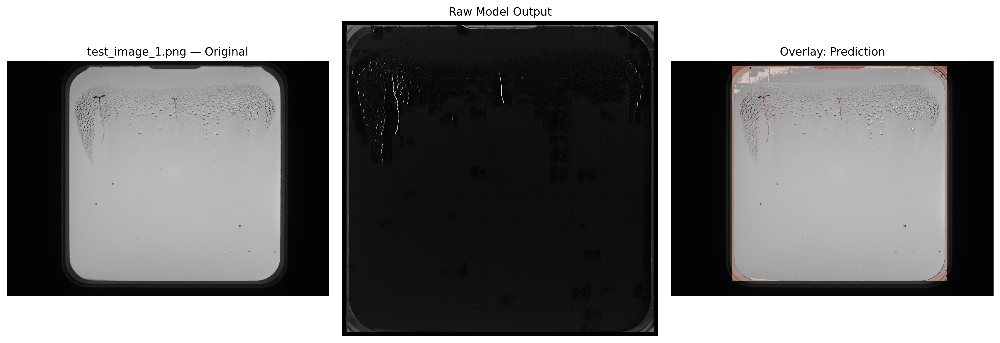


Processing test_image_10.png
Original image shape: 3006 x 4202
Petri dish image shape: (2774, 2774)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 233s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


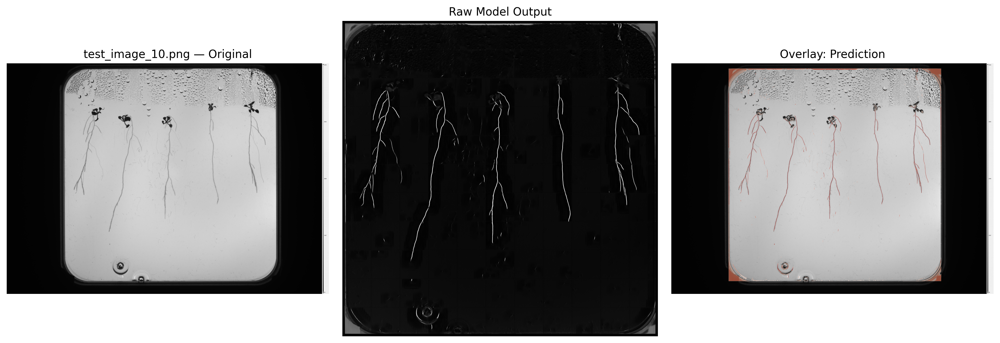


Processing test_image_11.png
Original image shape: 3006 x 4202
Petri dish image shape: (2774, 2774)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 226s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


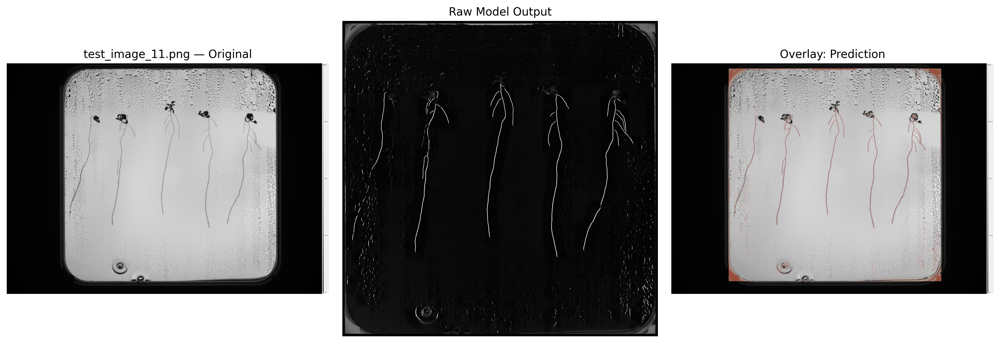


Processing test_image_2.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 215s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


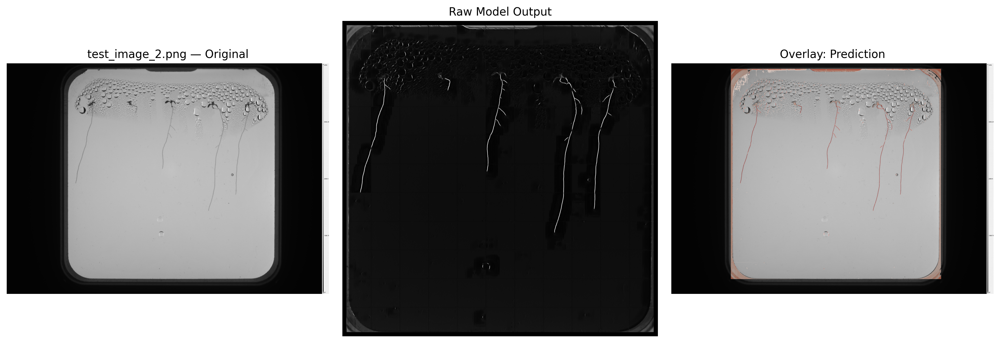


Processing test_image_3.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 222s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


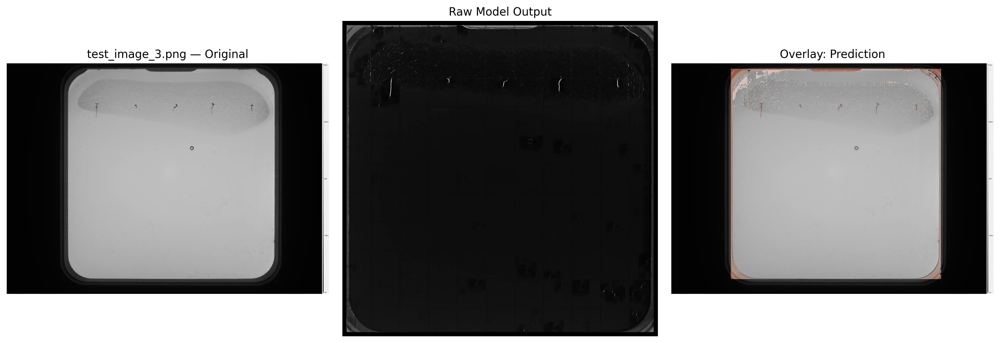


Processing test_image_4.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 255s 18s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


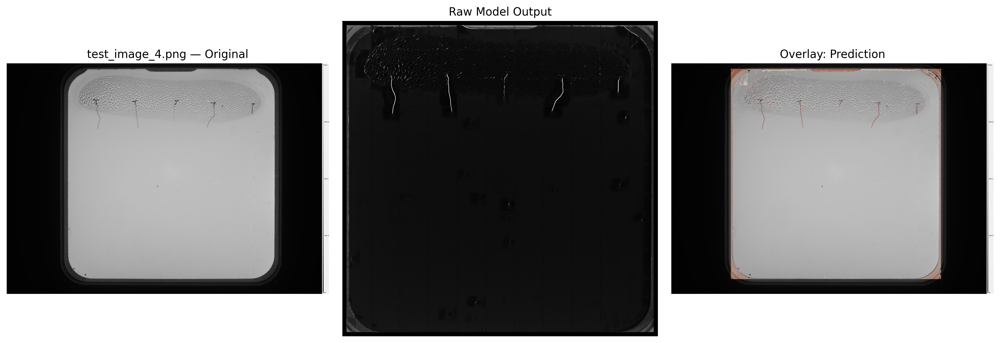


Processing test_image_5.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 279s 20s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


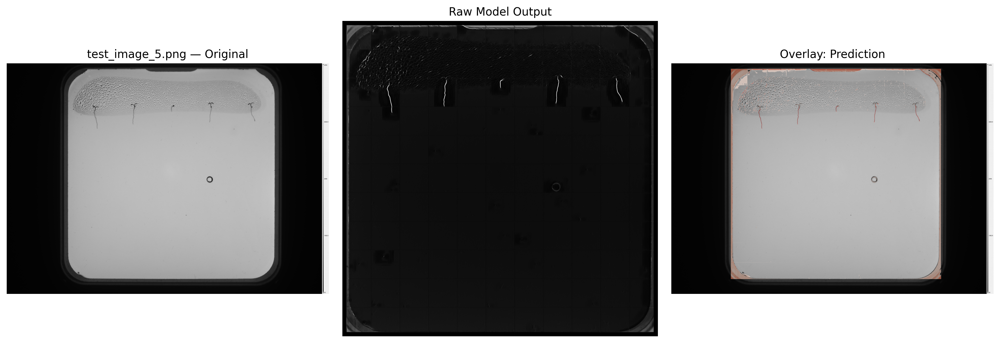


Processing test_image_6.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 199s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


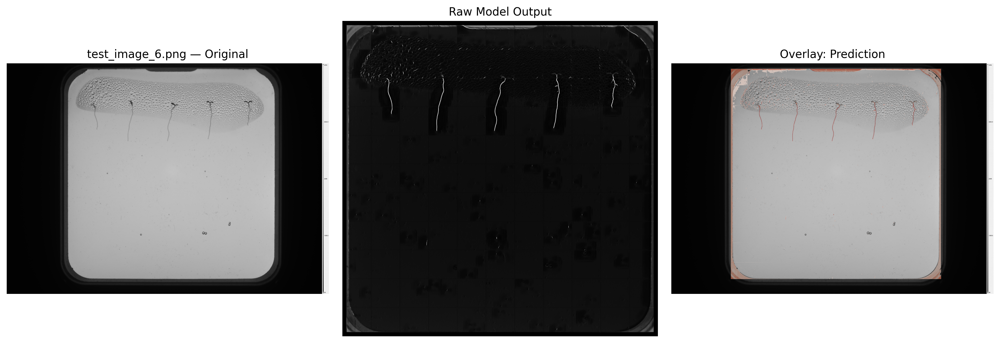


Processing test_image_7.png
Original image shape: 3006 x 4202
Petri dish image shape: (2742, 2742)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 223s 16s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


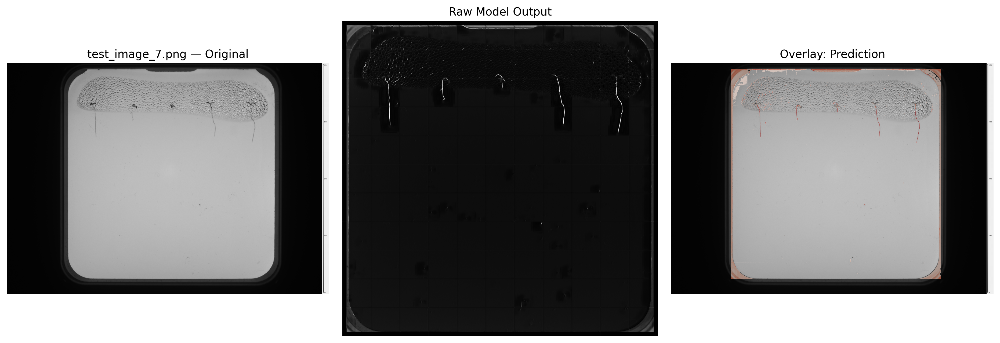


Processing test_image_8.png
Original image shape: 3006 x 4202
Petri dish image shape: (2743, 2743)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 248s 17s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


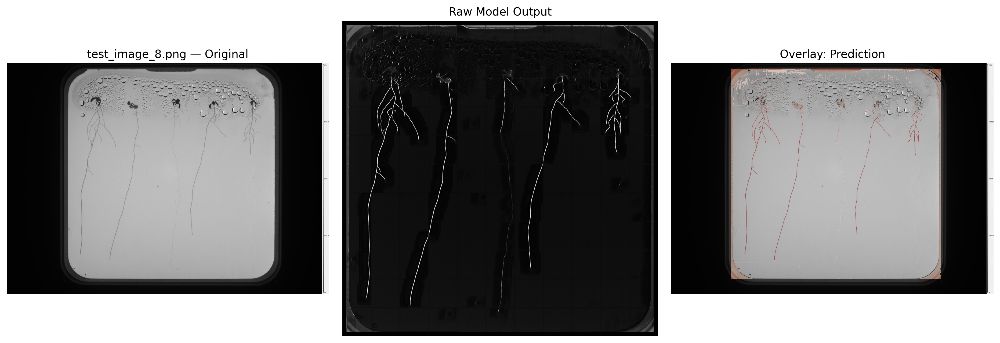


Processing test_image_9.png
Original image shape: 3006 x 4202
Petri dish image shape: (2774, 2774)
Padded image shape: (2816, 2816)
14/14 ━━━━━━━━━━━━━━━━━━━━ 210s 15s/step
Predicted mask shape: (2816, 2816)
Predicted mask corrected shape: (3006, 4202)


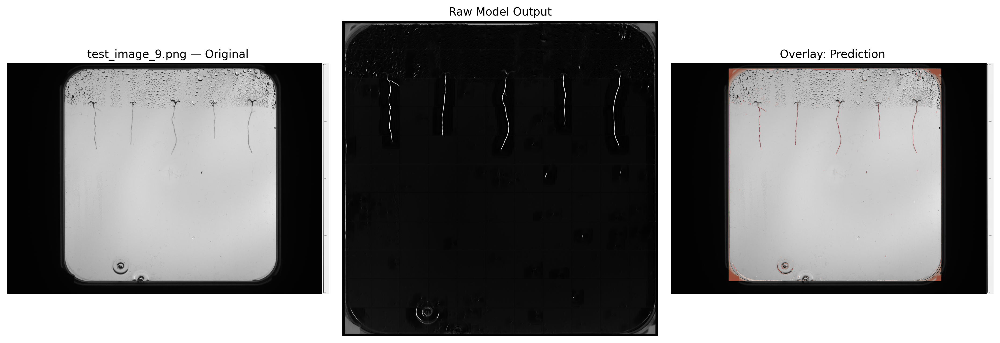

In [9]:
# Apply the predict_masks_raw() function to get the masks
raw_predictions = predict_masks(
    folder_path, 
    model,
    patch_size=patch_size
)

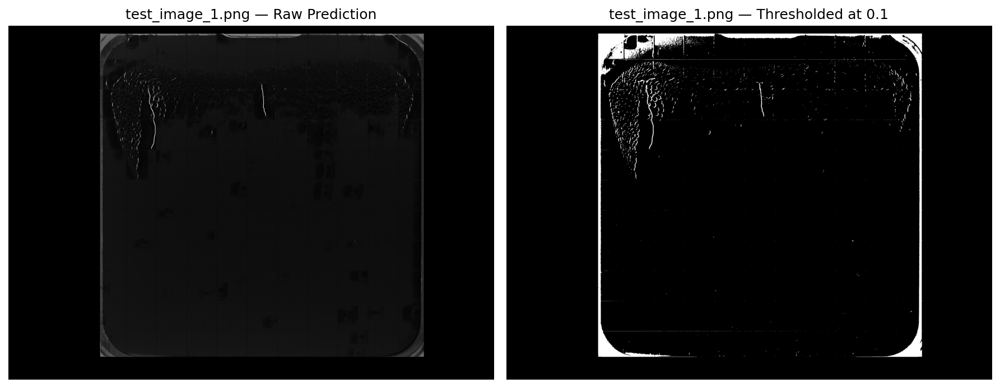

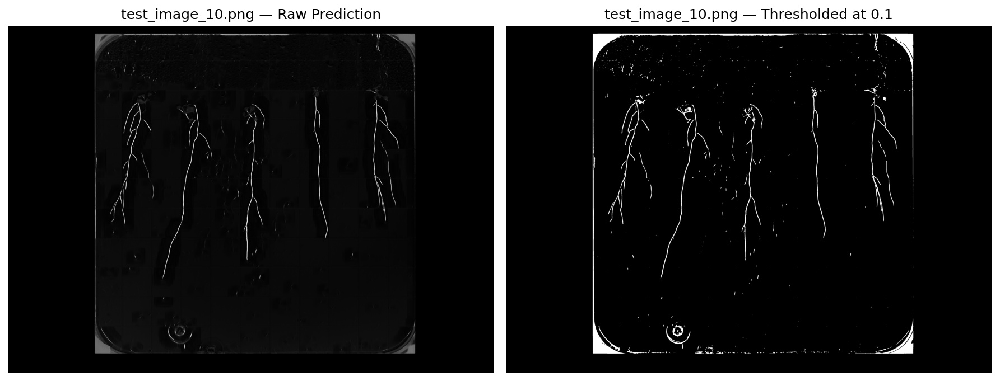

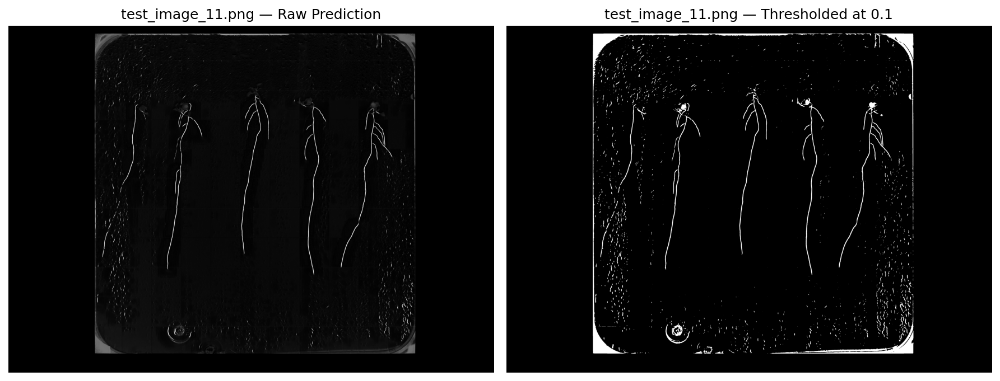

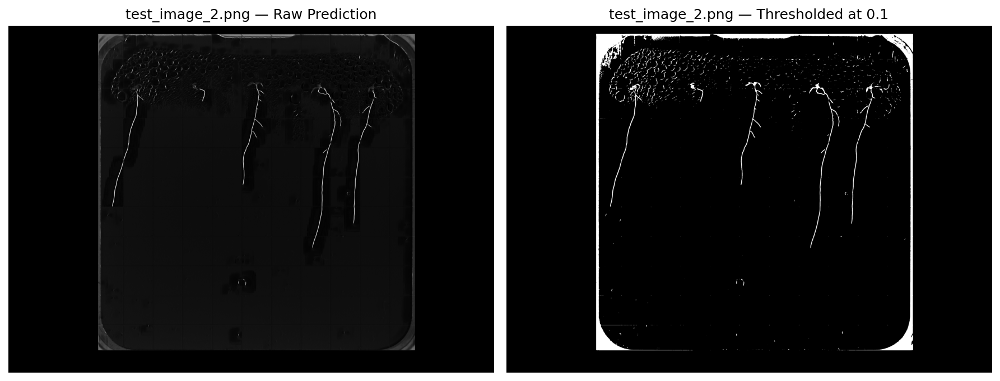

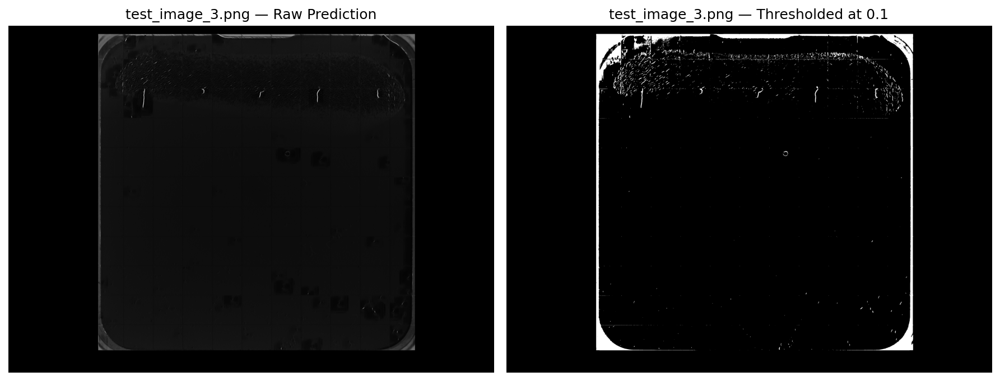

...

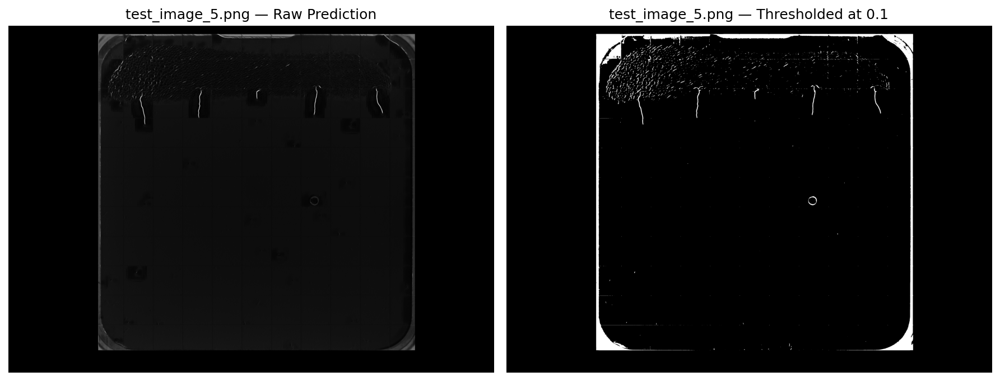

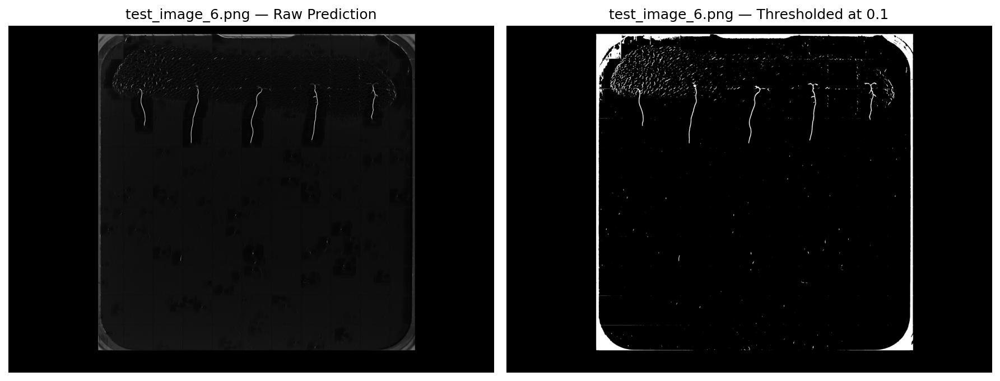

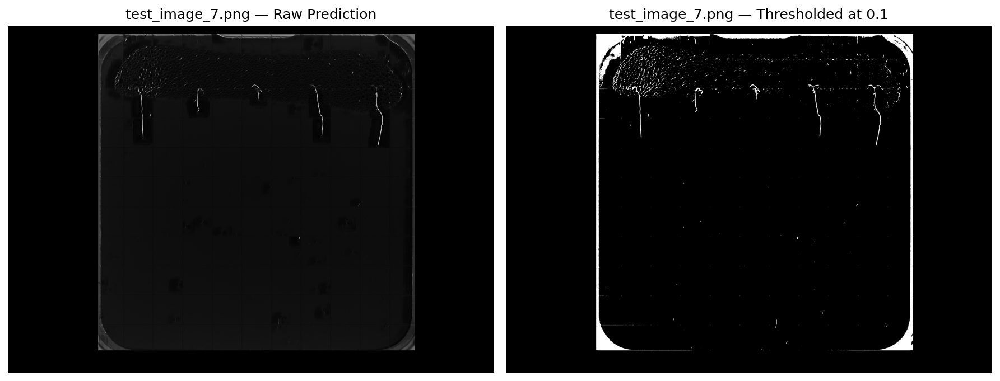

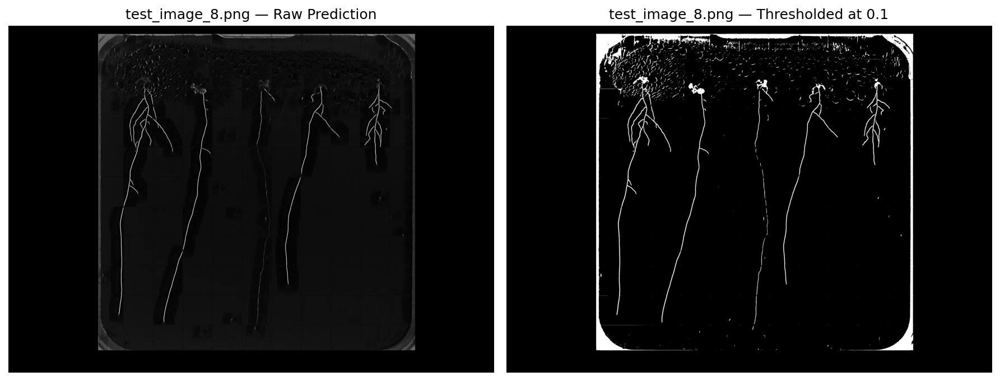

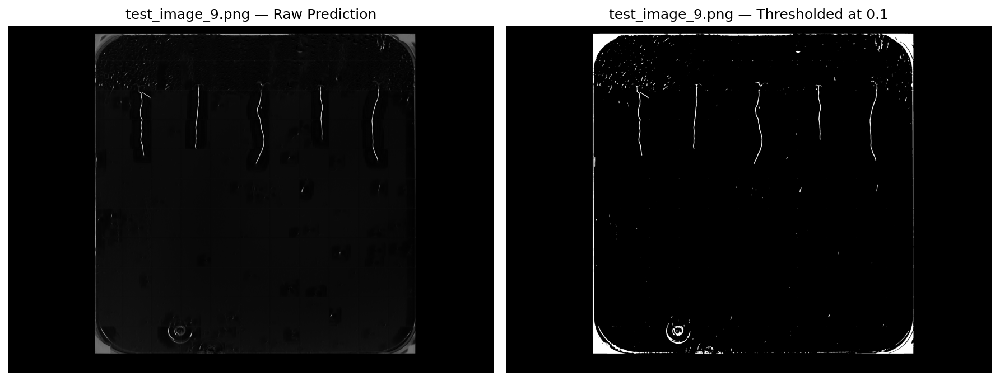

In [10]:
# Binarizing the masks with an appropriate threshold
threshold = 0.1
thresholded_masks = {}

for name, raw in raw_predictions.items():
    # Access the actual predicted mask
    mask = raw['mask']

    # Threshold the raw mask
    binary = (mask > threshold).astype(np.uint8)
    thresholded_masks[name] = binary

    # Display side-by-side
    plt.figure(figsize=(12, 5), dpi=150)
    plt.subplot(1, 2, 1)
    plt.imshow(mask, cmap='gray')
    plt.title(f'{name} — Raw Prediction')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(binary * 255, cmap='gray')
    plt.title(f'{name} — Thresholded at {threshold}')
    plt.axis('off')
    plt.tight_layout()
    plt.show()


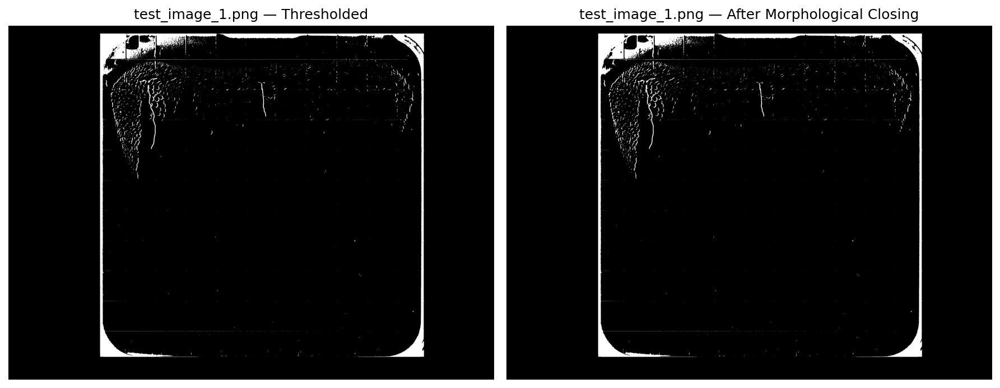

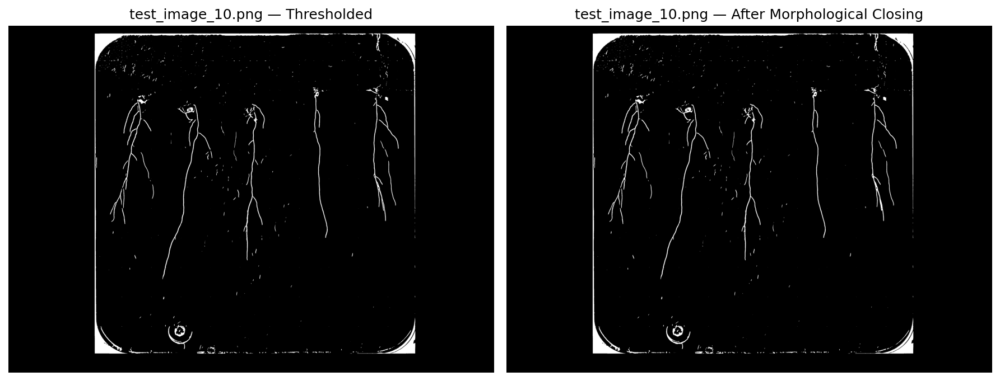

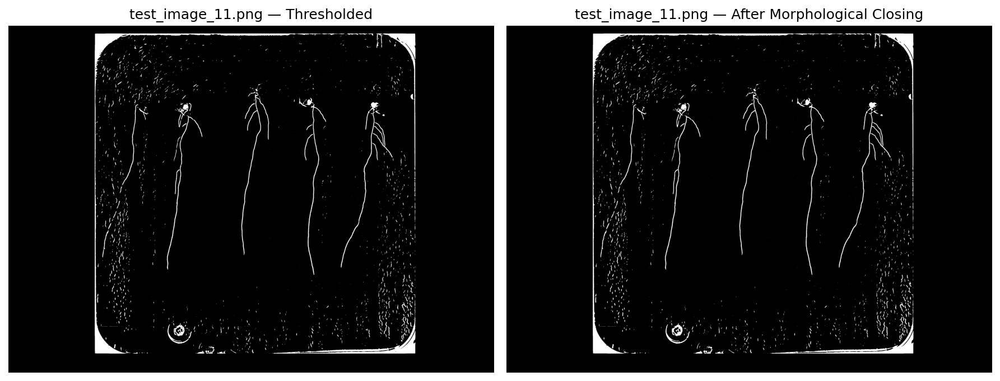

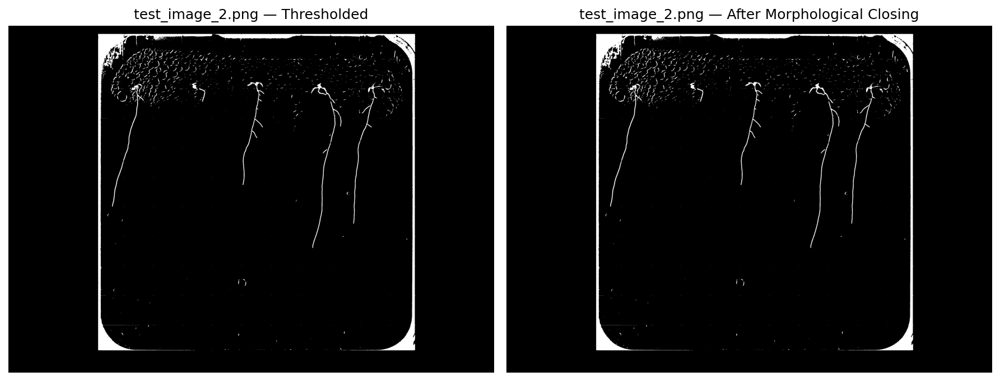

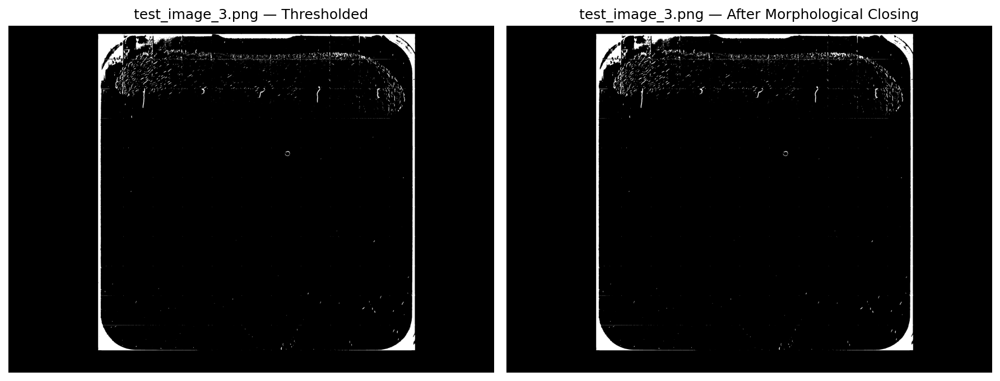

...

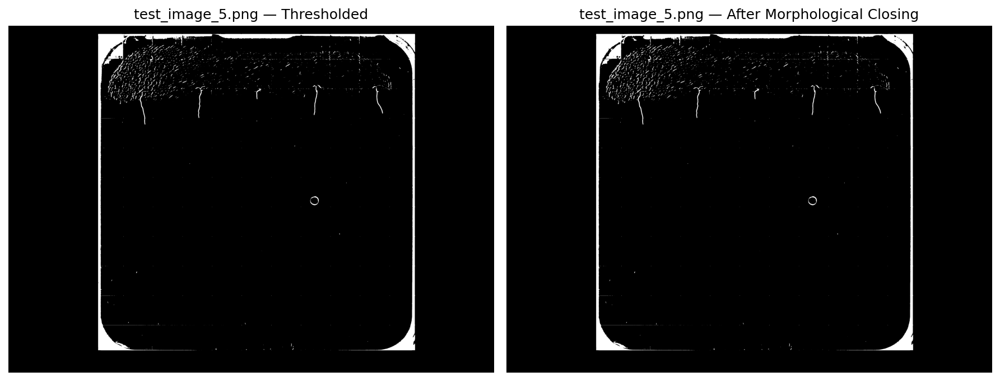

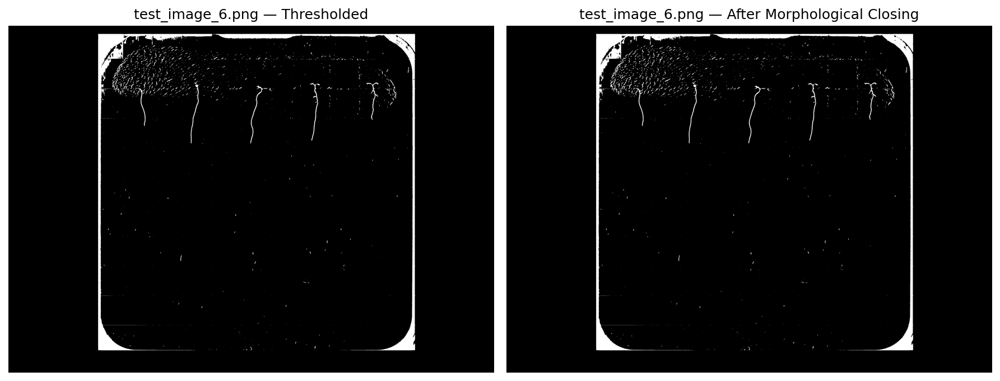

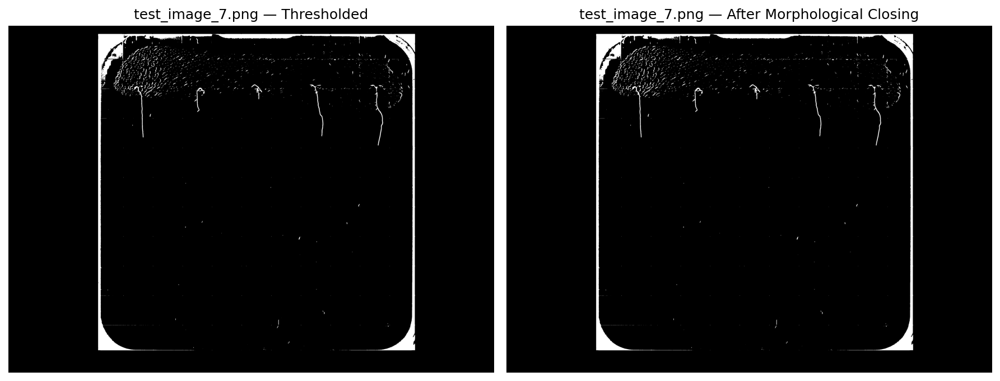

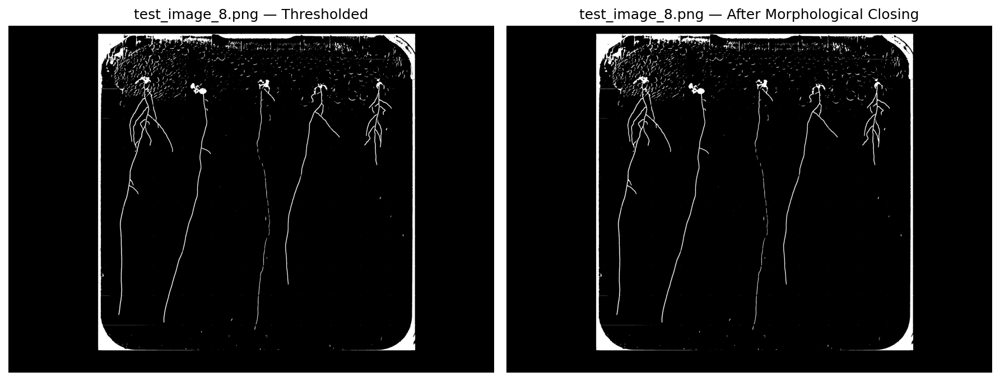

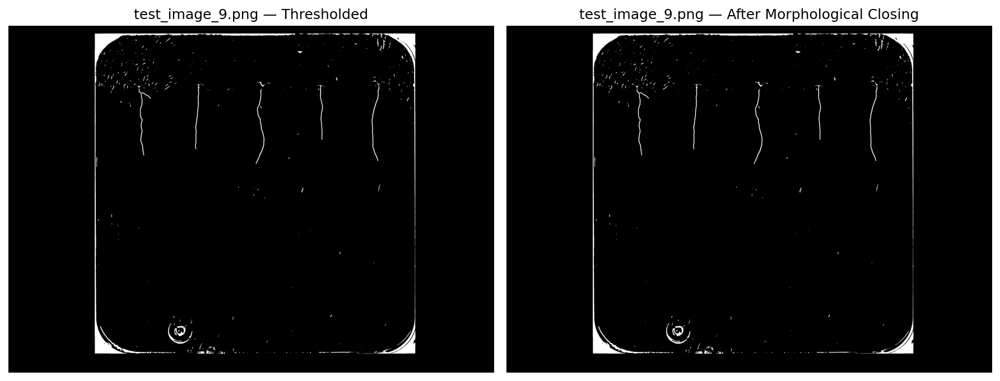

In [11]:
# Morphological closing
closed_masks = {}
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 3))

for name, binary in thresholded_masks.items():
    closed = binary.copy()
    for _ in range(3):  # apply closing 3 times
        closed = cv2.morphologyEx(closed, cv2.MORPH_CLOSE, kernel)
    closed_masks[name] = closed

    # Compare thresholded vs. closed
    plt.figure(figsize=(12, 5), dpi=150)
    plt.subplot(1, 2, 1)
    plt.imshow(binary * 255, cmap='gray')
    plt.title(f'{name} — Thresholded')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(closed * 255, cmap='gray')
    plt.title(f'{name} — After Morphological Closing')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

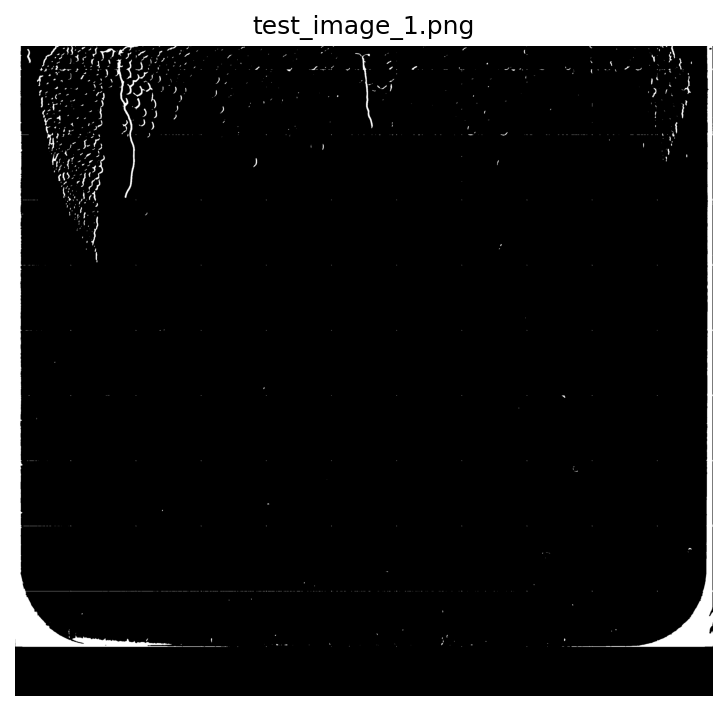

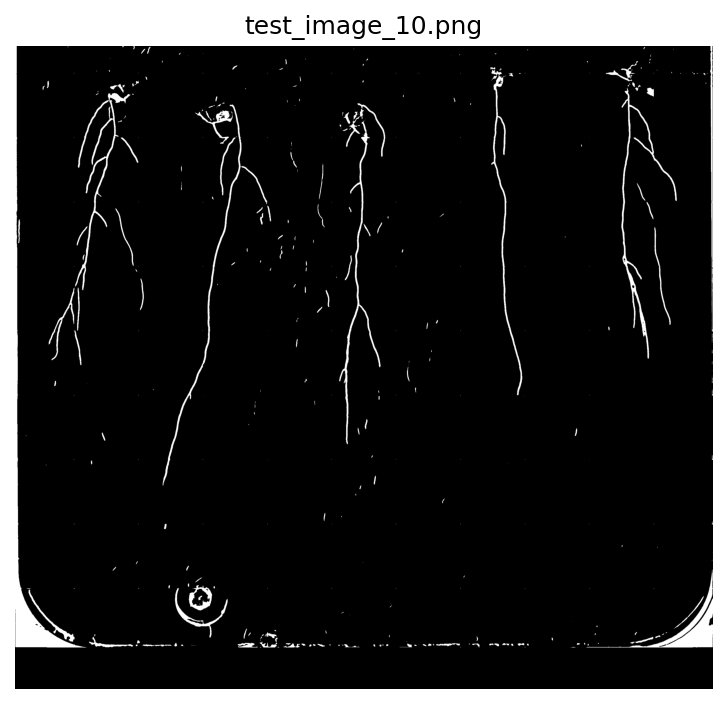

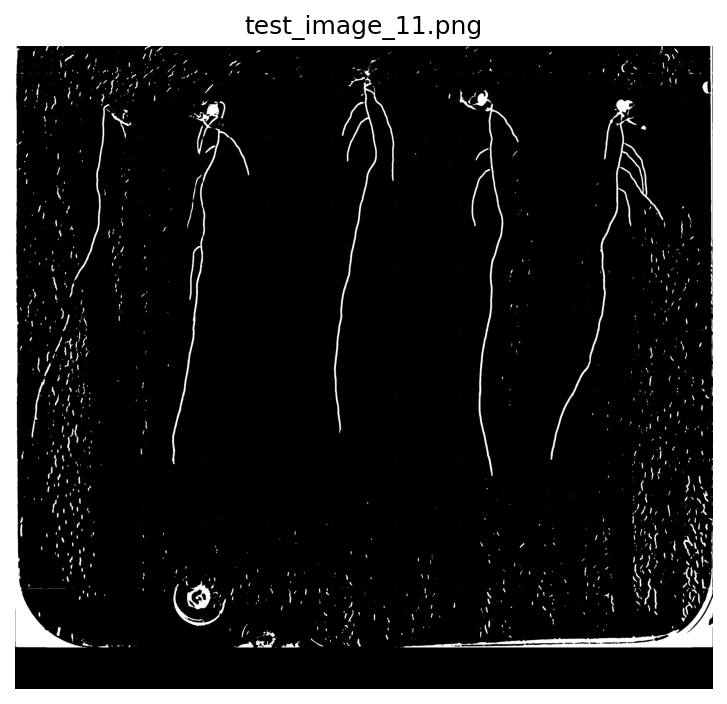

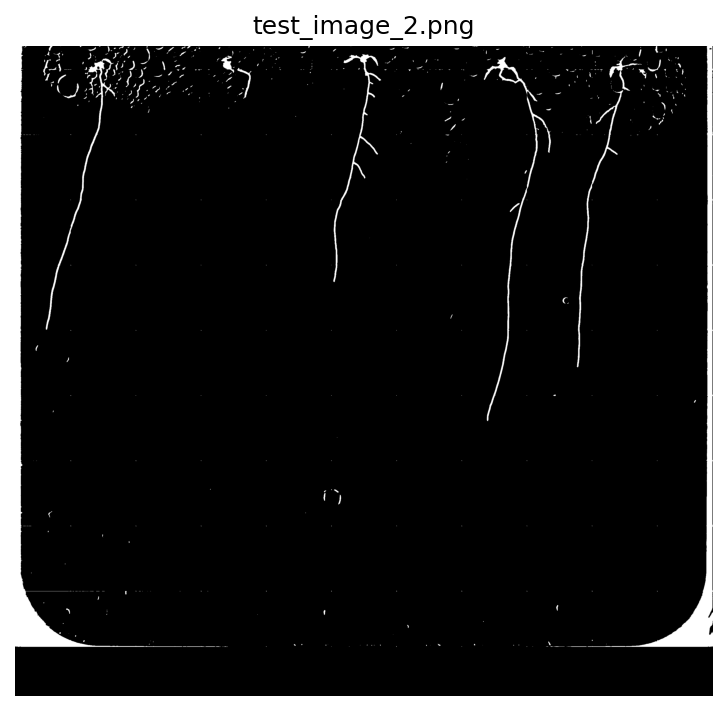

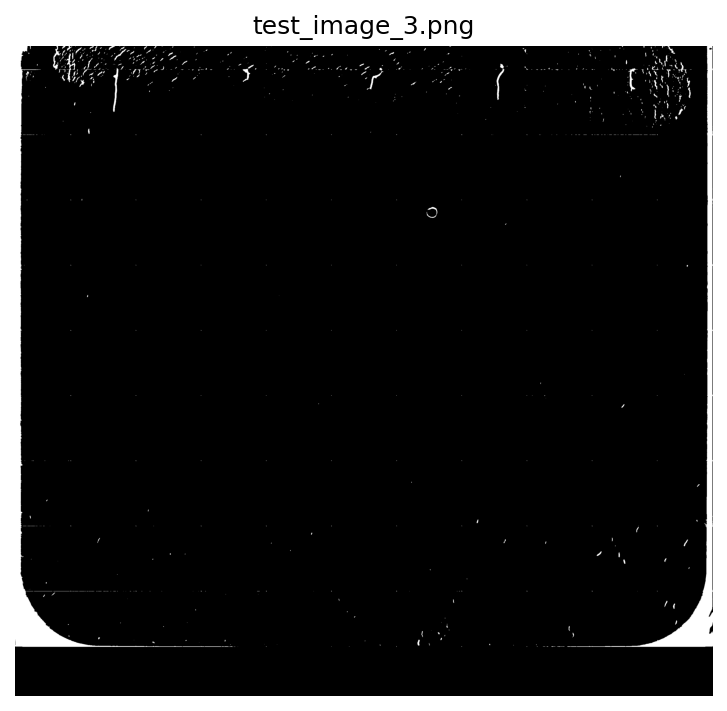

...

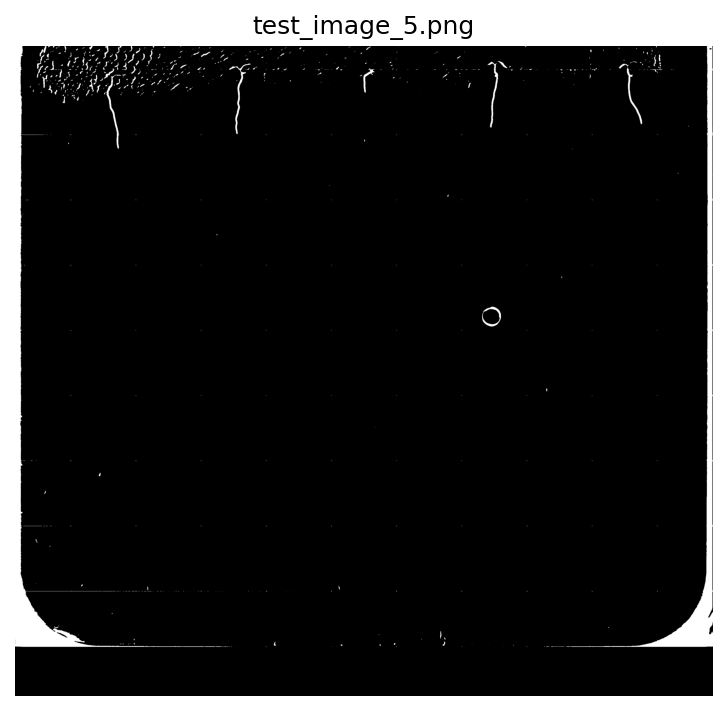

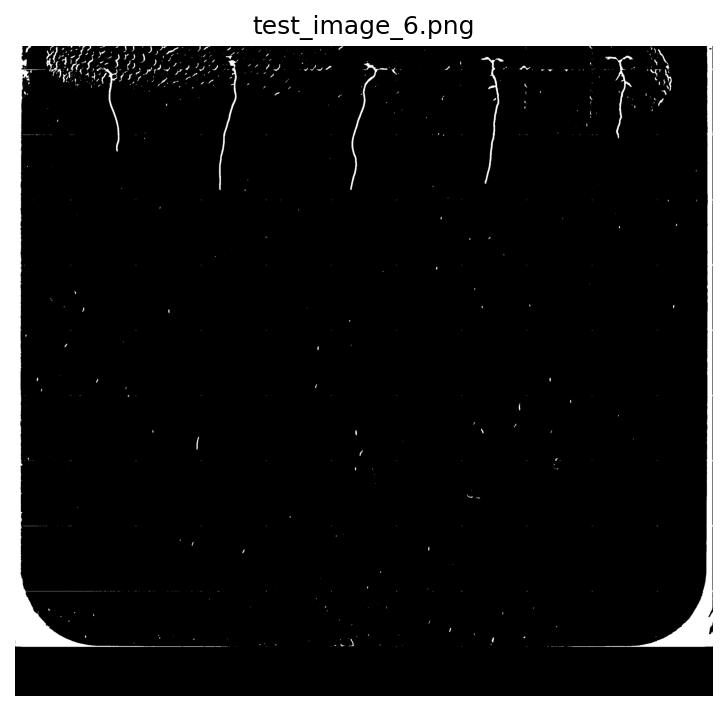

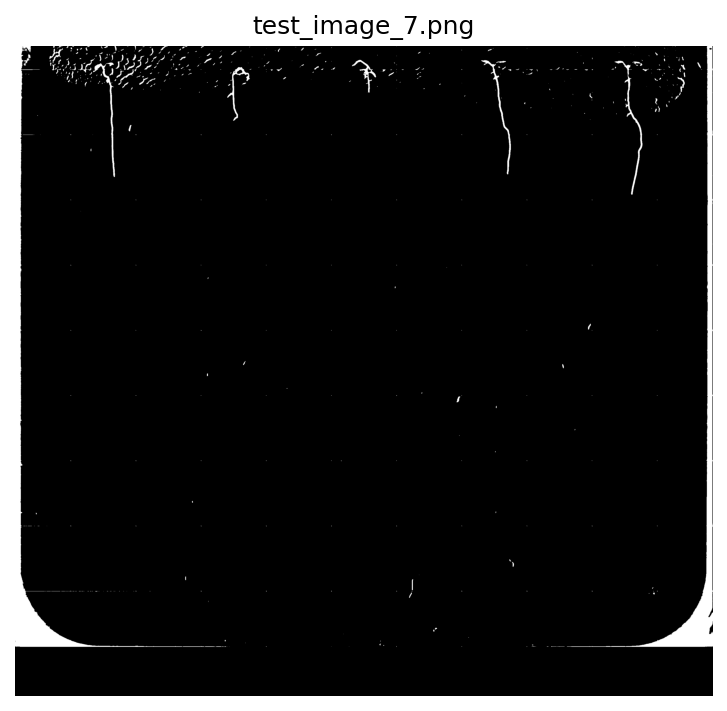

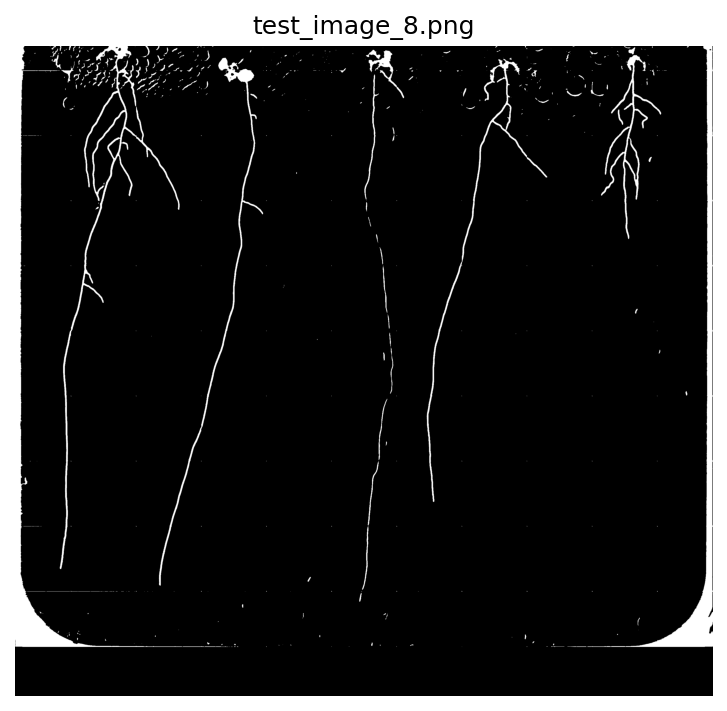

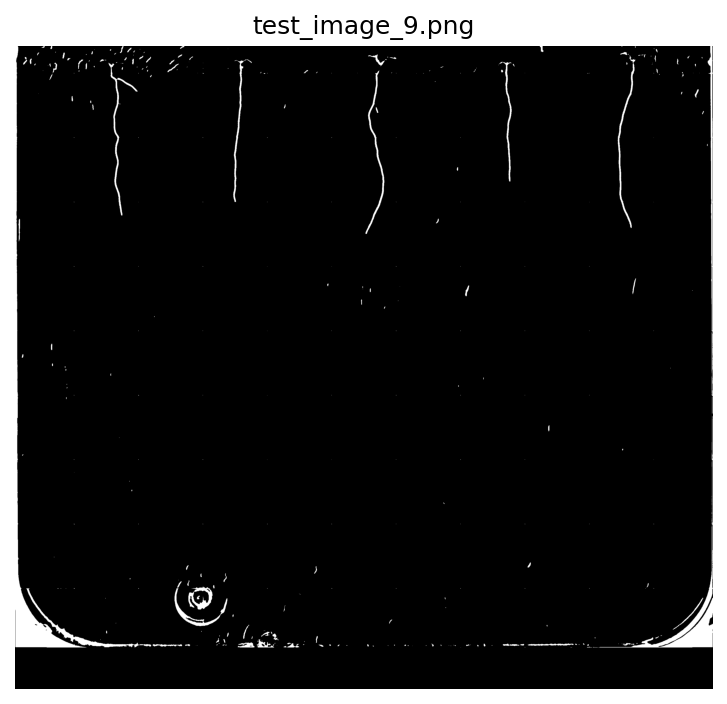

In [12]:
# Crop top + horizontally to petri dish bounds
dish_cropped_masks = {}
top_crop_ratio = 0.15  # Crop 15% from the top

for name, closed in closed_masks.items():
    # Get crop_info from earlier prediction step
    crop_info = raw_predictions[name]['crop_info']

    # Dish bounds
    x_start = crop_info['x_start']
    crop_size = crop_info['crop_size']
    x_end = min(x_start + crop_size, closed.shape[1])

    # Horizontal crop to match Petri dish width
    horizontally_cropped = closed[:, x_start:x_end]

    # Crop top x% to avoid noise above seed region
    h = horizontally_cropped.shape[0]
    top_crop = int(h * top_crop_ratio)
    final_cropped = horizontally_cropped[top_crop:, :]

    # Save result
    dish_cropped_masks[name] = final_cropped

    # Visualize result
    plt.figure(figsize=(6, 6), dpi=150)
    plt.imshow(final_cropped * 255, cmap='gray')
    plt.title(f'{name}')
    plt.axis('off')
    plt.show()

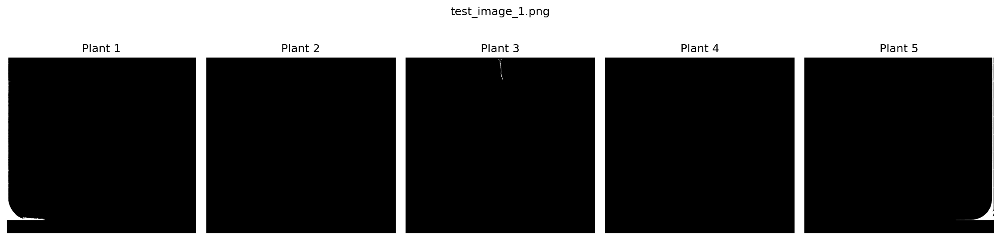

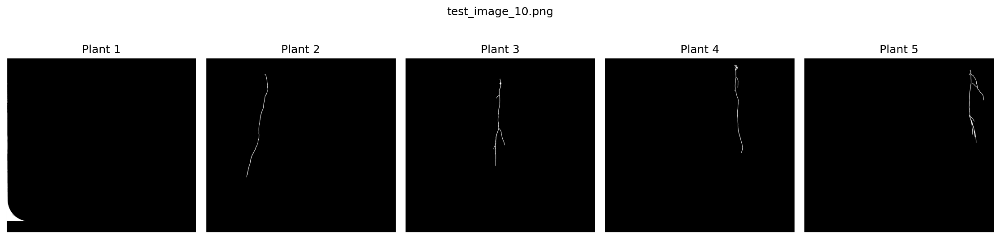

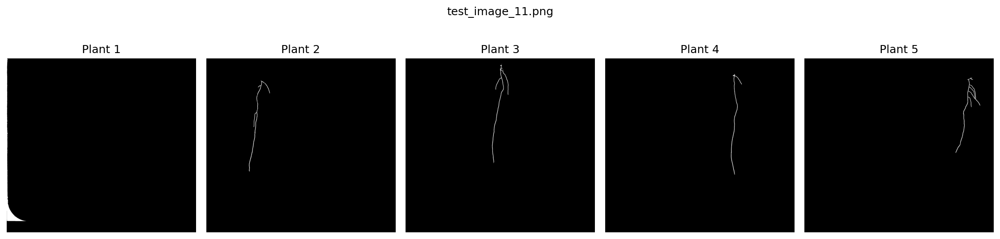

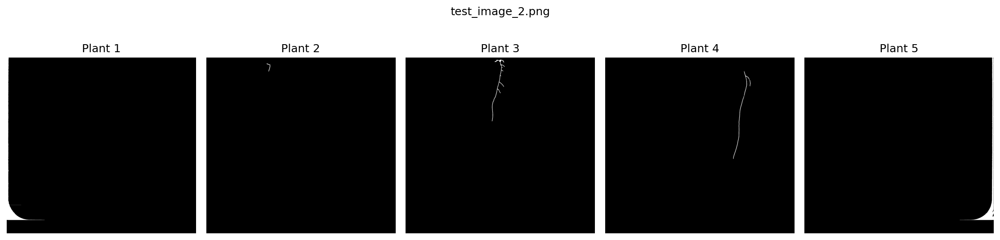

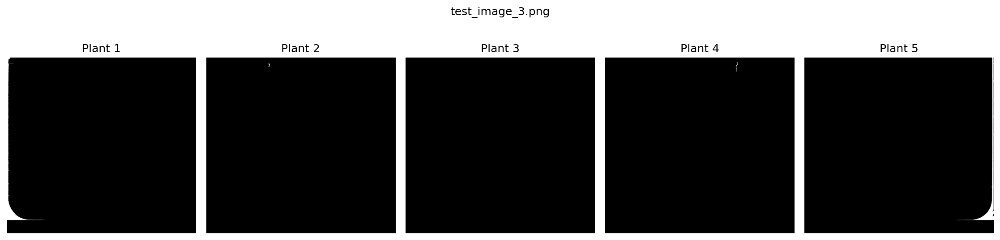

...

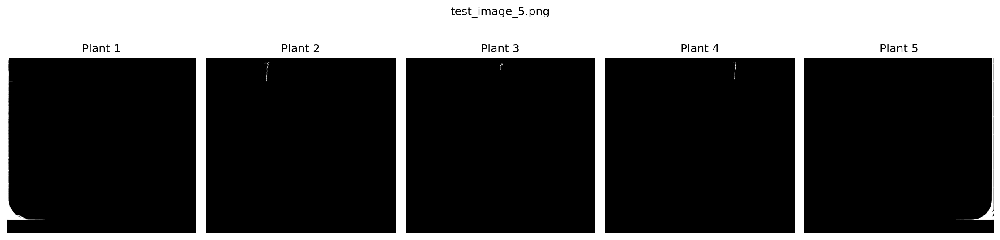

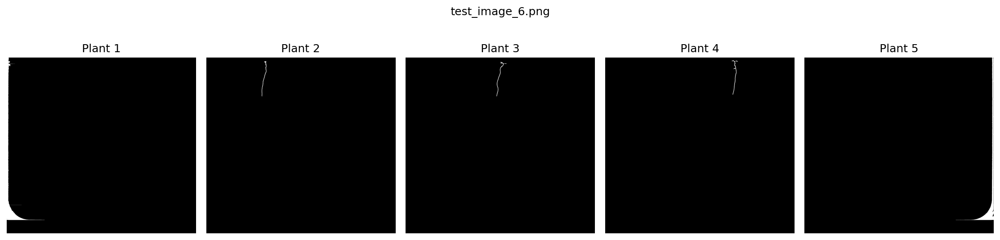

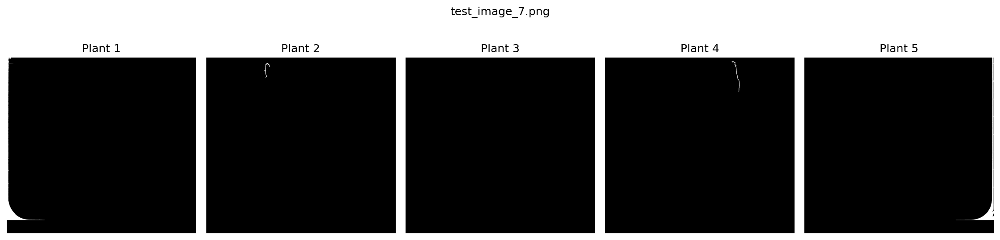

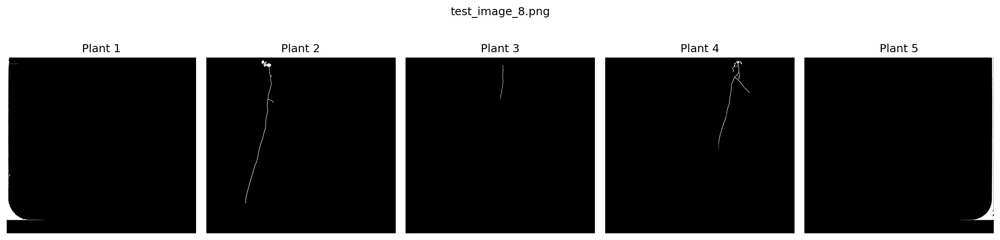

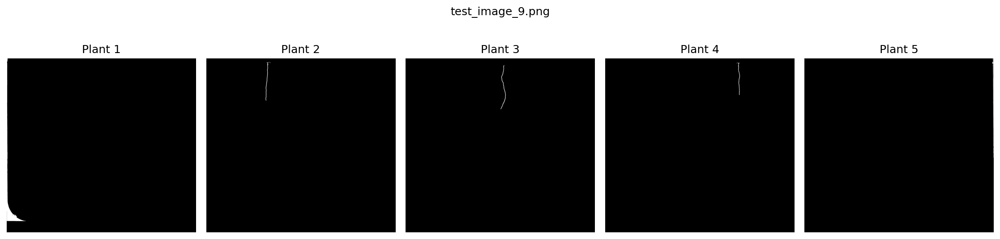

In [13]:
# Settings
num_plants = 5
min_area = 250
min_pixels = 350
aspect_ratio_threshold = 1.5  # height must be 1.5x width to be considered vertical
vertical_start_thresh_ratio = 0.3

segmented_root_masks = {}

for name, mask in dish_cropped_masks.items():
    h, w = mask.shape
    band_width = w // num_plants

    plant_masks = []

    for i in range(num_plants):
        # Define vertical band (ROI)
        x_start = i * band_width
        x_end = (i + 1) * band_width if i < num_plants - 1 else w
        roi = mask[:, x_start:x_end]

        # Connected Components within band
        num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(roi)

        best_component = None
        best_area = 0

        for j in range(1, num_labels):
            x, y, cw, ch, area = stats[j]

            if area < min_area:
                continue

            aspect_ratio = ch / cw if cw > 0 else 0
            if aspect_ratio < aspect_ratio_threshold:
                continue

            if y > int(h * vertical_start_thresh_ratio):
                continue

            if area > best_area:
                best_area = area
                best_component = (labels == j).astype(np.uint8)

        # Prepare mask for this plant
        full_mask = np.zeros_like(mask, dtype=np.uint8)
        if best_component is not None:
            full_mask[:, x_start:x_end] = best_component
            full_mask = (full_mask * 255).astype(np.uint8)

        plant_masks.append(full_mask)

    segmented_root_masks[name] = plant_masks

    # Visualize
    plt.figure(figsize=(15, 4), dpi=150)
    for i in range(num_plants):
        plt.subplot(1, num_plants, i + 1)
        plt.imshow(plant_masks[i], cmap='gray')
        plt.title(f'Plant {i + 1}')
        plt.axis('off')
    plt.suptitle(f"{name}")
    plt.tight_layout()
    plt.show()

In [14]:
# Folder to save final root masks
save_dir = "/Volumes/T7/Artificial Intelligence/YEAR 2.1/Block B retake/task8/01_task8_masks"
os.makedirs(save_dir, exist_ok=True)

# Dict to store them in memory for later processing
final_root_masks = {}

# Save and store
for name, plant_masks in segmented_root_masks.items():
    base_name = os.path.splitext(name)[0]  # e.g. 'test_image_1'

    for idx, mask in enumerate(plant_masks):
        plant_num = idx + 1
        key = f"{base_name}_plant_{plant_num}"
        filename = f"{key}.png"
        filepath = os.path.join(save_dir, filename)

        # Save the mask to file
        cv2.imwrite(filepath, mask)

        # Store in dict
        final_root_masks[key] = mask

        print(f"Saved and stored: {key}")

Saved and stored: test_image_1_plant_1
Saved and stored: test_image_1_plant_2
Saved and stored: test_image_1_plant_3
Saved and stored: test_image_1_plant_4
Saved and stored: test_image_1_plant_5
Saved and stored: test_image_10_plant_1
Saved and stored: test_image_10_plant_2
Saved and stored: test_image_10_plant_3
Saved and stored: test_image_10_plant_4
Saved and stored: test_image_10_plant_5
Saved and stored: test_image_11_plant_1
Saved and stored: test_image_11_plant_2
Saved and stored: test_image_11_plant_3
Saved and stored: test_image_11_plant_4
Saved and stored: test_image_11_plant_5
Saved and stored: test_image_2_plant_1
Saved and stored: test_image_2_plant_2
Saved and stored: test_image_2_plant_3
Saved and stored: test_image_2_plant_4
Saved and stored: test_image_2_plant_5
Saved and stored: test_image_3_plant_1
Saved and stored: test_image_3_plant_2
Saved and stored: test_image_3_plant_3
Saved and stored: test_image_3_plant_4
Saved and stored: test_image_3_plant_5
Saved and store

Saved and stored: test_image_5_plant_1
Saved and stored: test_image_5_plant_2
Saved and stored: test_image_5_plant_3
Saved and stored: test_image_5_plant_4
Saved and stored: test_image_5_plant_5
Saved and stored: test_image_6_plant_1
Saved and stored: test_image_6_plant_2
Saved and stored: test_image_6_plant_3
Saved and stored: test_image_6_plant_4
Saved and stored: test_image_6_plant_5
Saved and stored: test_image_7_plant_1
Saved and stored: test_image_7_plant_2
Saved and stored: test_image_7_plant_3
Saved and stored: test_image_7_plant_4
Saved and stored: test_image_7_plant_5
Saved and stored: test_image_8_plant_1
Saved and stored: test_image_8_plant_2
Saved and stored: test_image_8_plant_3
Saved and stored: test_image_8_plant_4
Saved and stored: test_image_8_plant_5
Saved and stored: test_image_9_plant_1
Saved and stored: test_image_9_plant_2
Saved and stored: test_image_9_plant_3
Saved and stored: test_image_9_plant_4
Saved and stored: test_image_9_plant_5



test_image_1_plant_1


/var/folders/51/q8610wk14l7cms9l0yvvgkkw0000gn/T/ipykernel_70724/216473157.py:31: VisibleDeprecationWarning: separator in column name will change to _ in version 0.13; to silence this warning, use `separator='-'` to maintain current behavior and use `separator='_'` to switch to the new default behavior.
  branch_data = summarize(skeleton_obj)


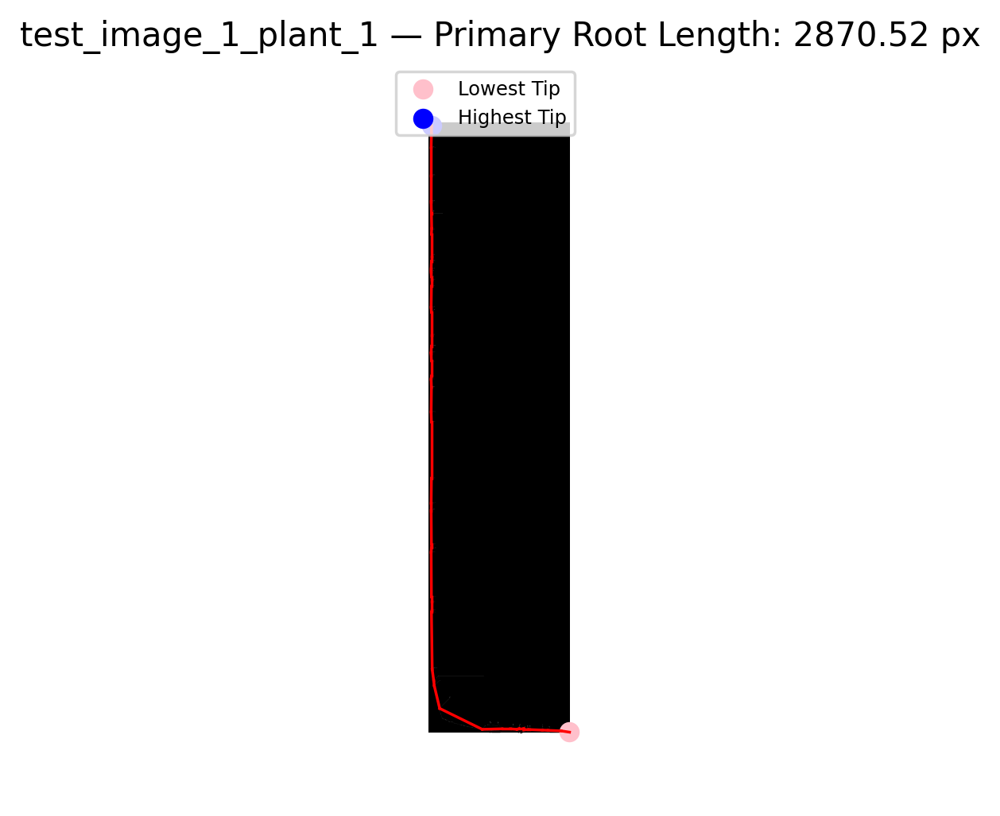

Primary root length: 2870.52 pixels
Start tip: [2360  546]
End tip: [10 12]

test_image_1_plant_2
No components found.

test_image_1_plant_3


/var/folders/51/q8610wk14l7cms9l0yvvgkkw0000gn/T/ipykernel_70724/216473157.py:31: VisibleDeprecationWarning: separator in column name will change to _ in version 0.13; to silence this warning, use `separator='-'` to maintain current behavior and use `separator='_'` to switch to the new default behavior.
  branch_data = summarize(skeleton_obj)


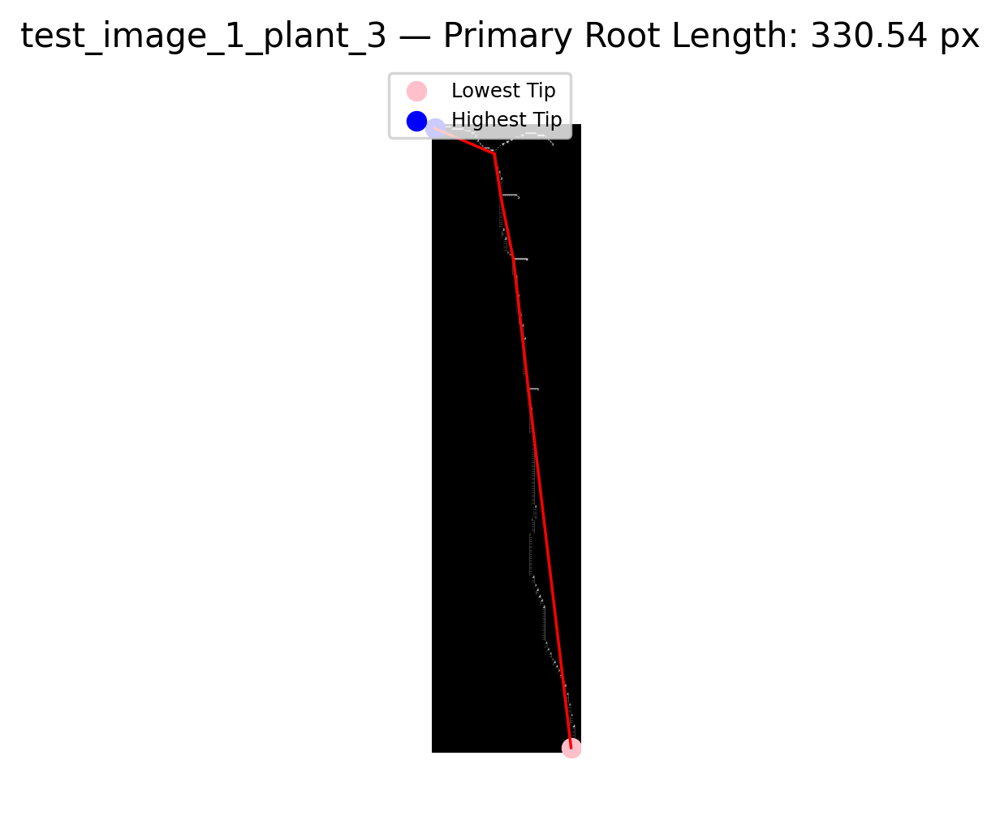

Primary root length: 330.54 pixels
Start tip: [292  65]
End tip: [1 1]

test_image_1_plant_4
No components found.

test_image_1_plant_5


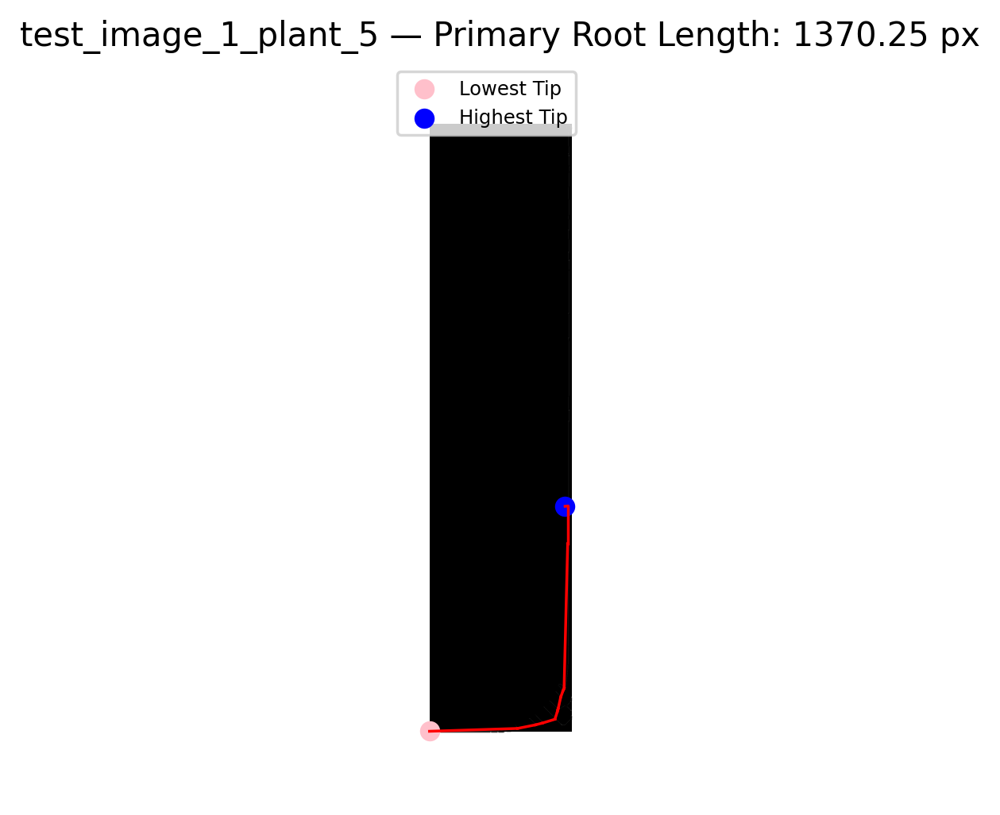

Primary root length: 1370.25 pixels
Start tip: [2361    0]
End tip: [1486  527]

test_image_10_plant_1


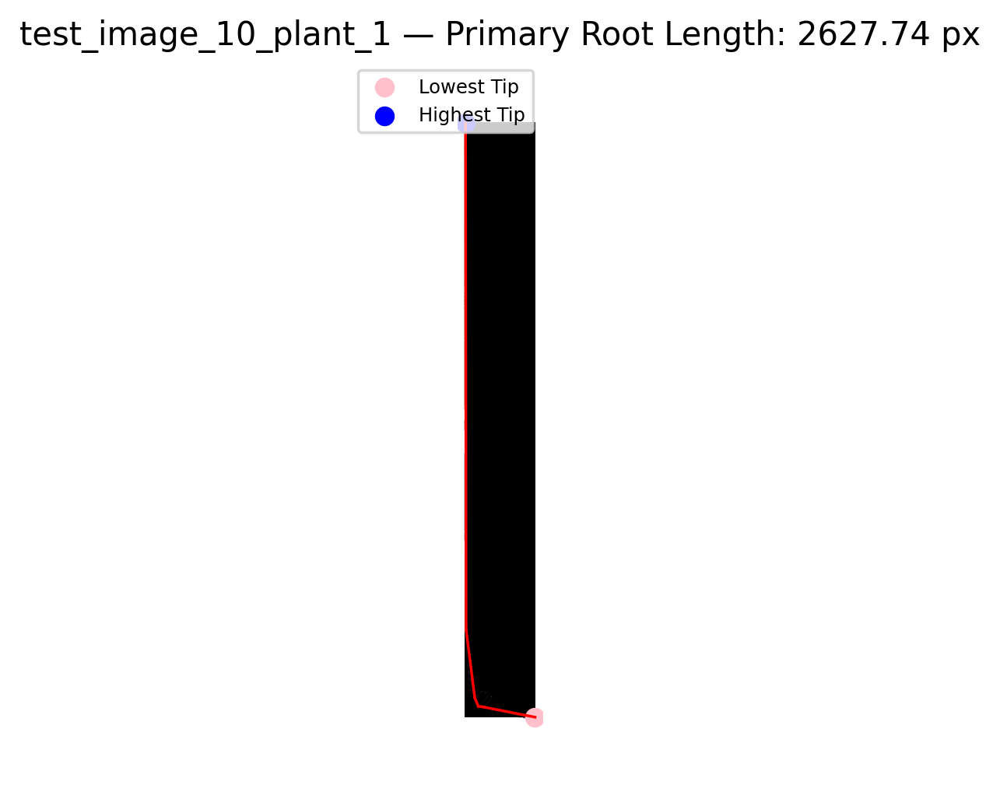

Primary root length: 2627.74 pixels
Start tip: [2390  283]
End tip: [2 4]

test_image_10_plant_2


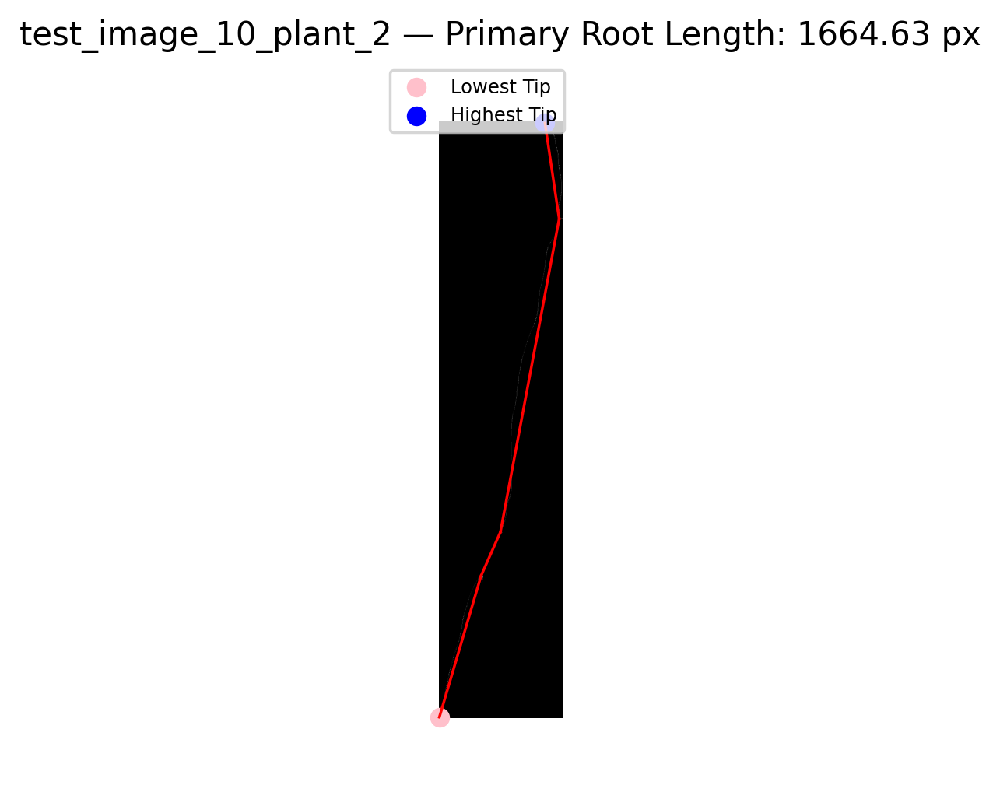

Primary root length: 1664.63 pixels
Start tip: [1511    1]
End tip: [  3 269]

test_image_10_plant_3


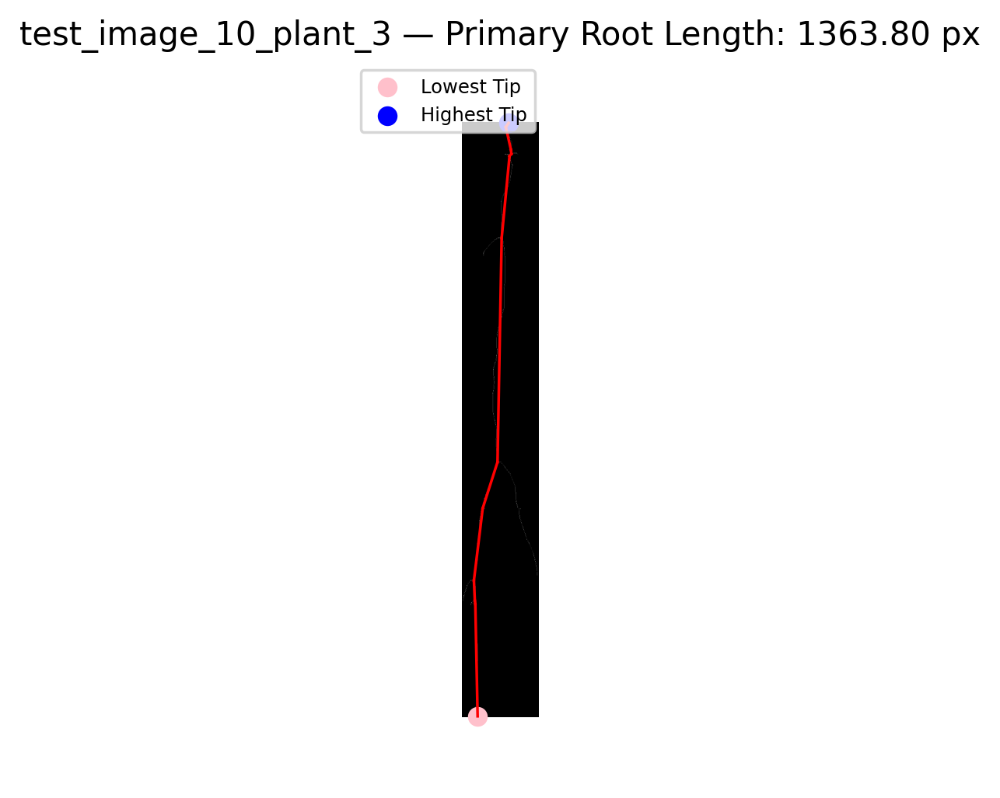

Primary root length: 1363.80 pixels
Start tip: [1284   33]
End tip: [  0 100]

test_image_10_plant_4


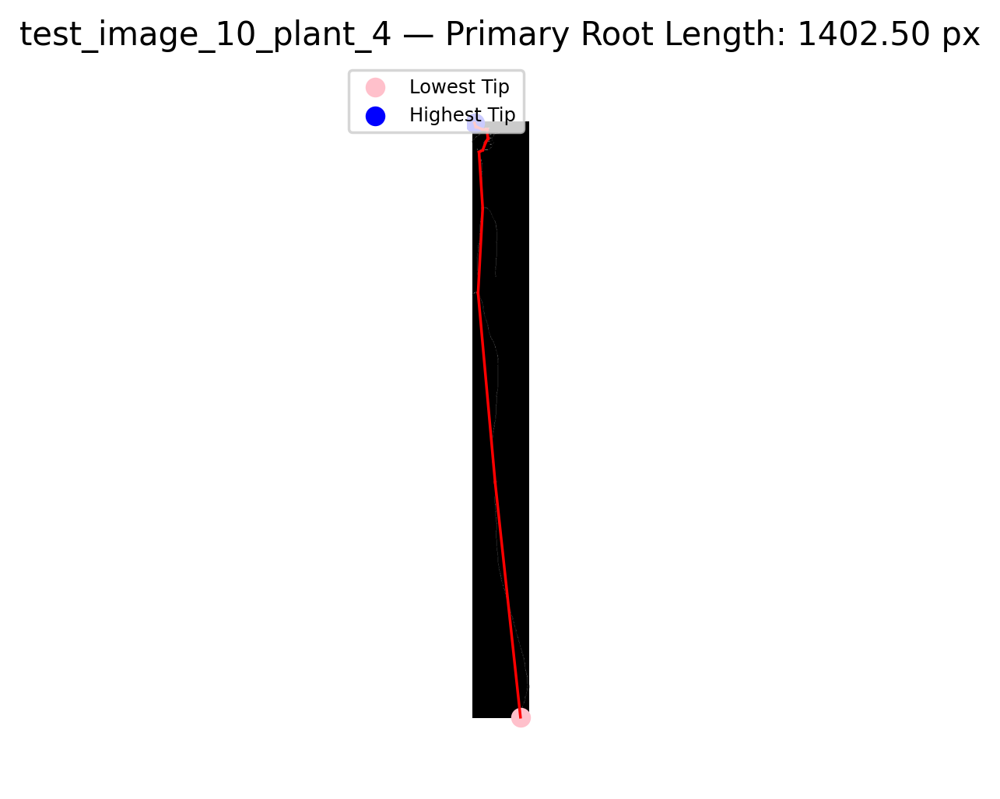

Primary root length: 1402.50 pixels
Start tip: [1291  104]
End tip: [1 4]

test_image_10_plant_5


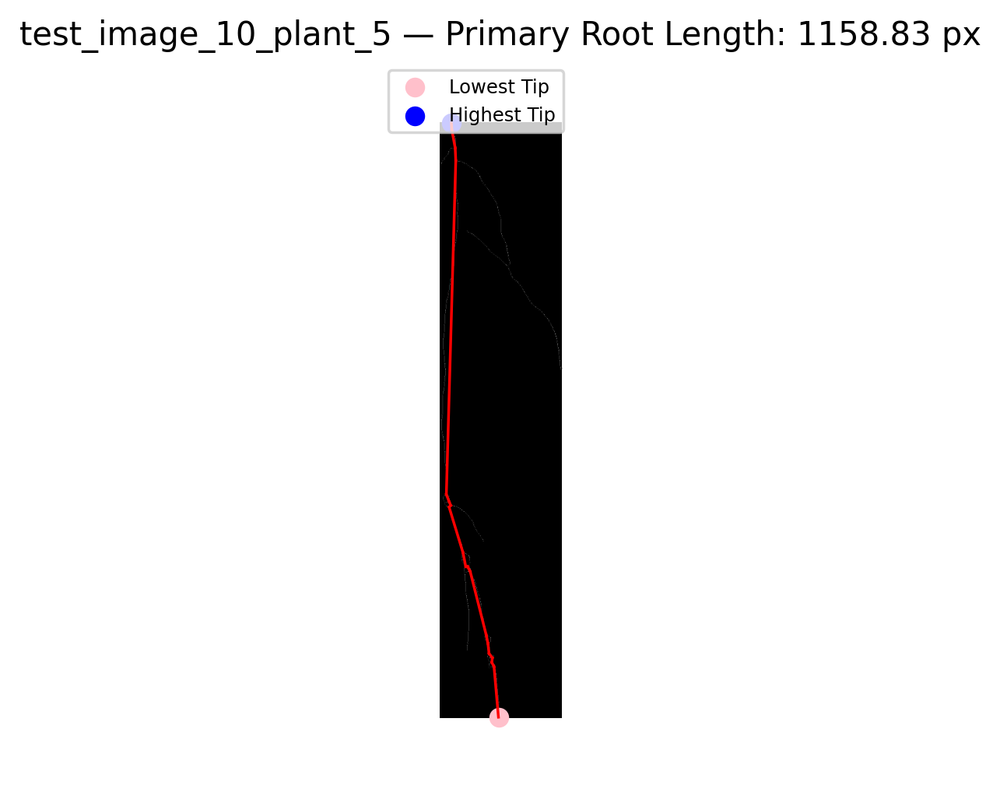

Primary root length: 1158.83 pixels
Start tip: [1073  106]
End tip: [ 1 21]

test_image_11_plant_1


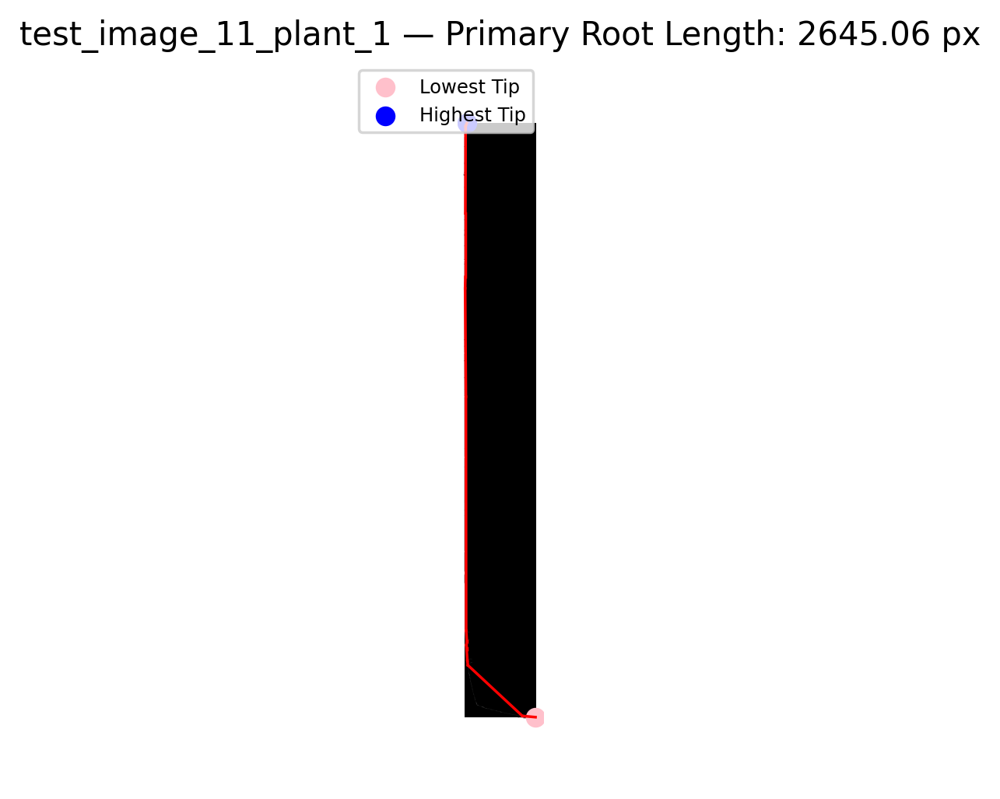

Primary root length: 2645.06 pixels
Start tip: [2390  285]
End tip: [0 9]

test_image_11_plant_2


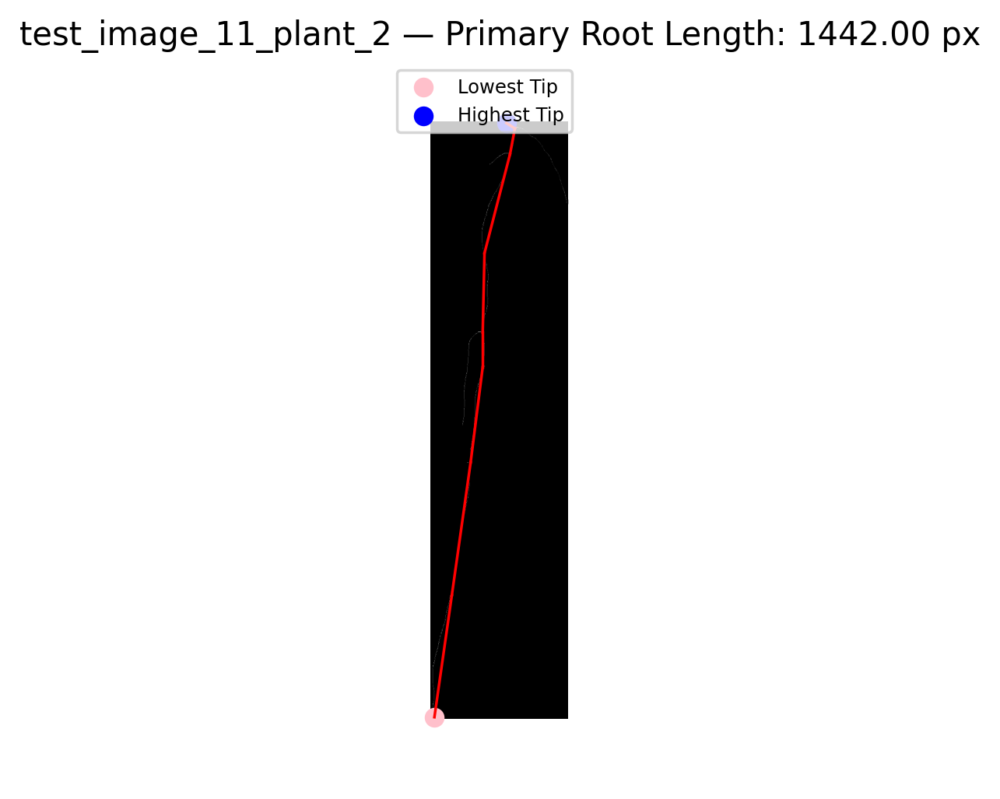

Primary root length: 1442.00 pixels
Start tip: [1330    8]
End tip: [  1 169]

test_image_11_plant_3


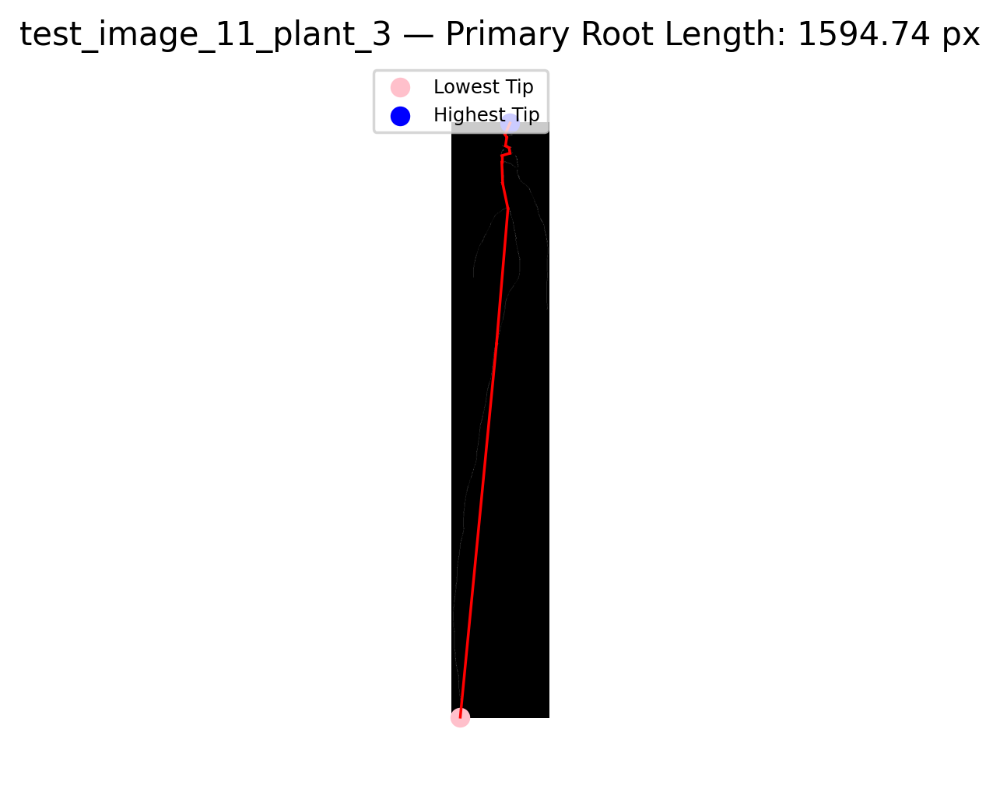

Primary root length: 1594.74 pixels
Start tip: [1459   22]
End tip: [  0 144]

test_image_11_plant_4


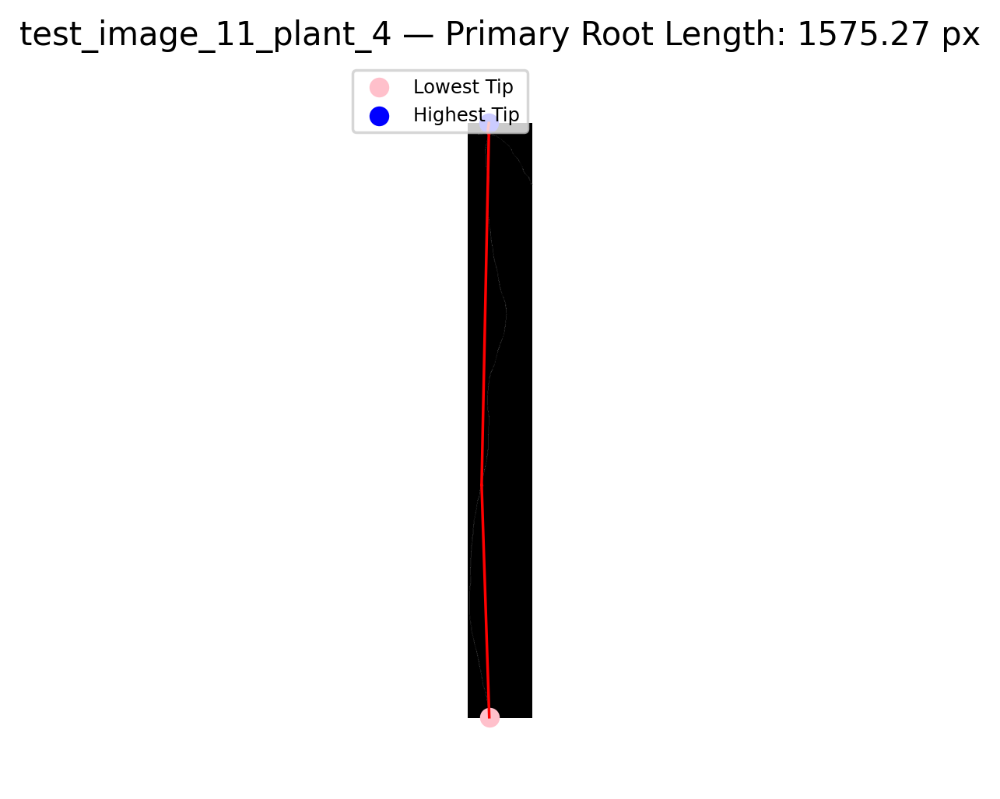

Primary root length: 1575.27 pixels
Start tip: [1479   53]
End tip: [ 0 52]

test_image_11_plant_5


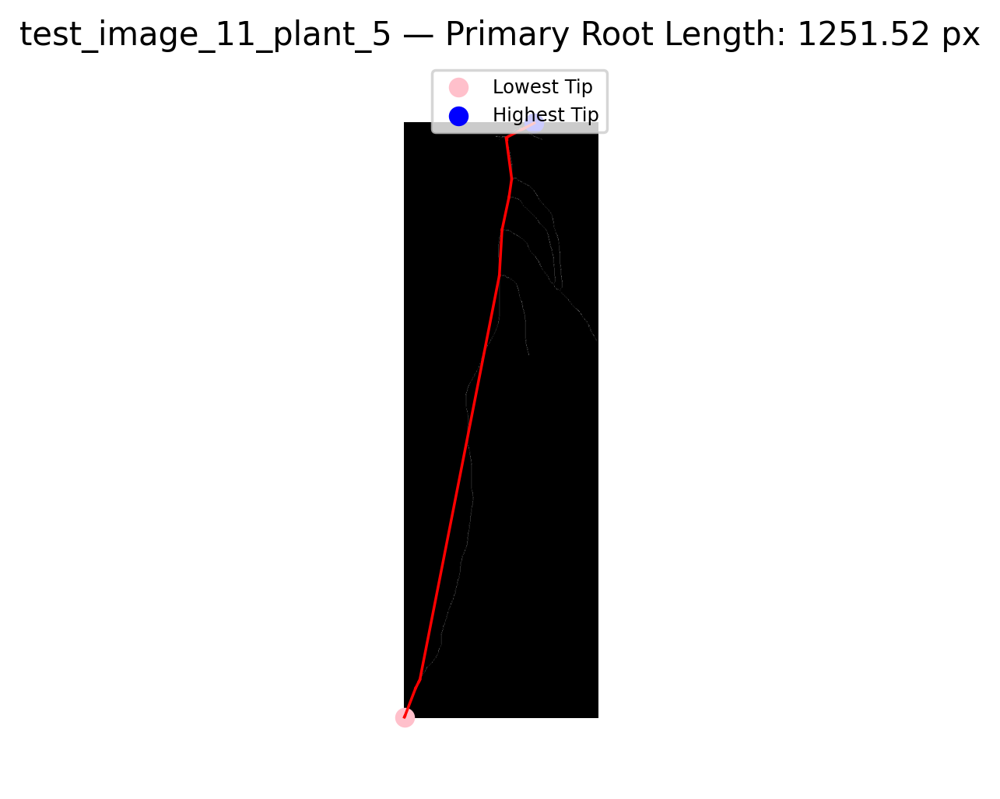

Primary root length: 1251.52 pixels
Start tip: [1107    0]
End tip: [  0 242]

test_image_2_plant_1


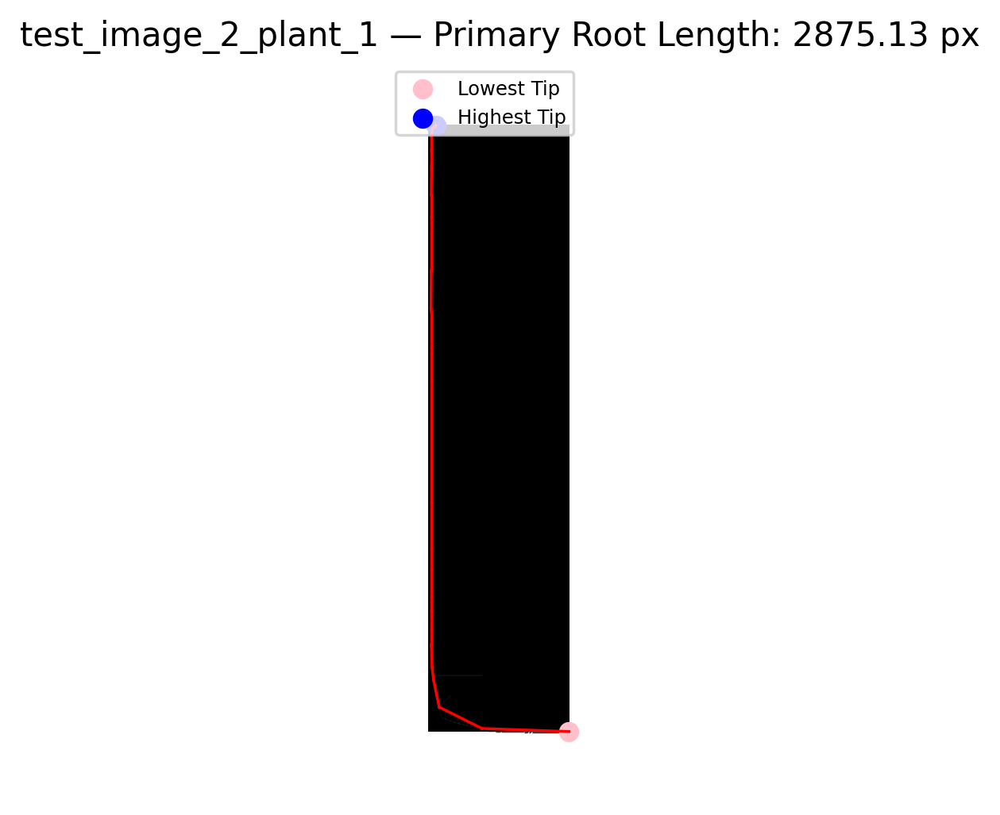

Primary root length: 2875.13 pixels
Start tip: [2361  547]
End tip: [ 0 29]

test_image_2_plant_2


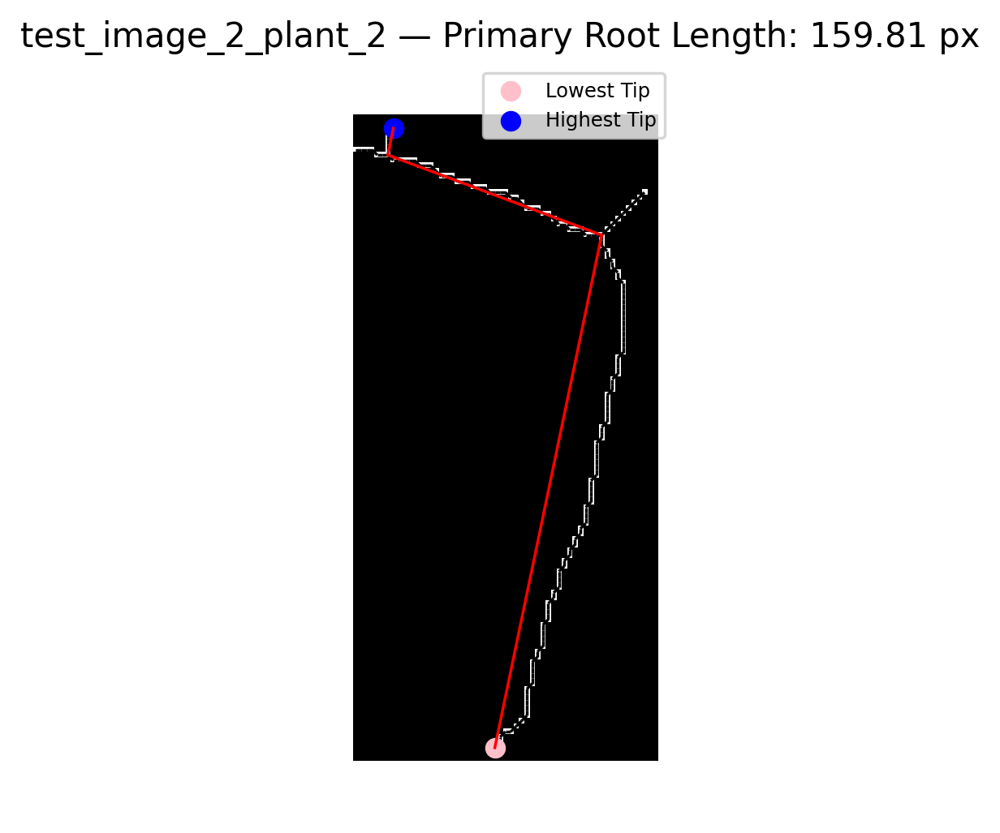

Primary root length: 159.81 pixels
Start tip: [118  26]
End tip: [2 7]

test_image_2_plant_3


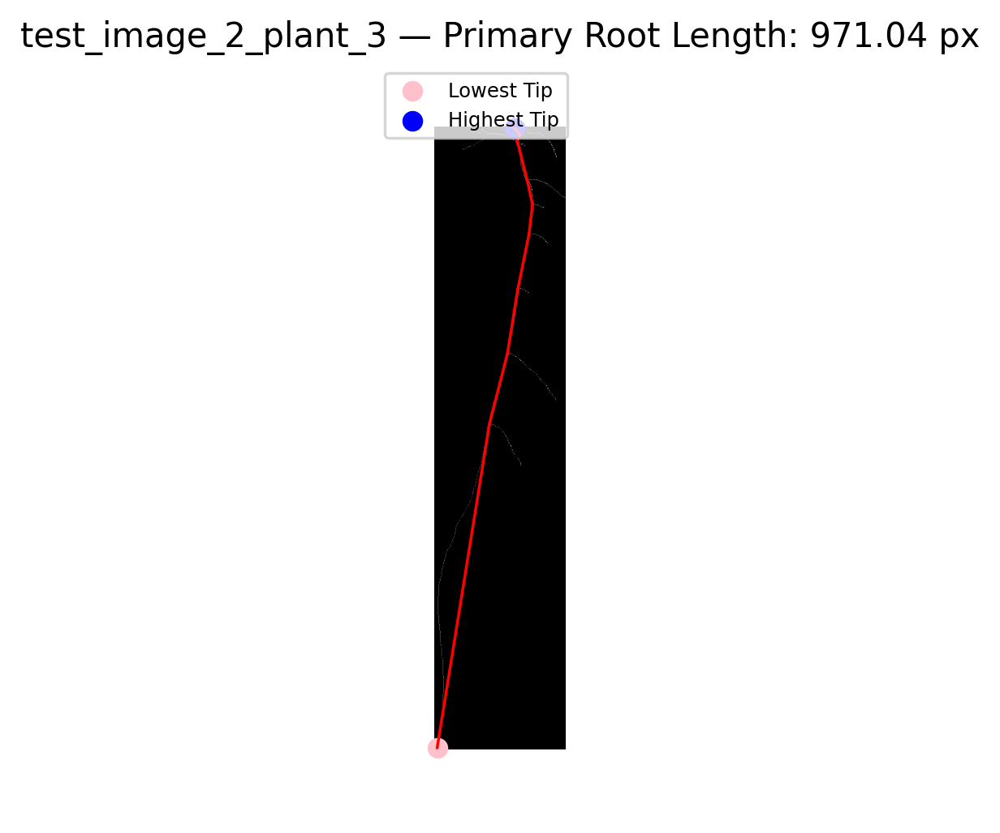

Primary root length: 971.04 pixels
Start tip: [892   4]
End tip: [  1 115]

test_image_2_plant_4


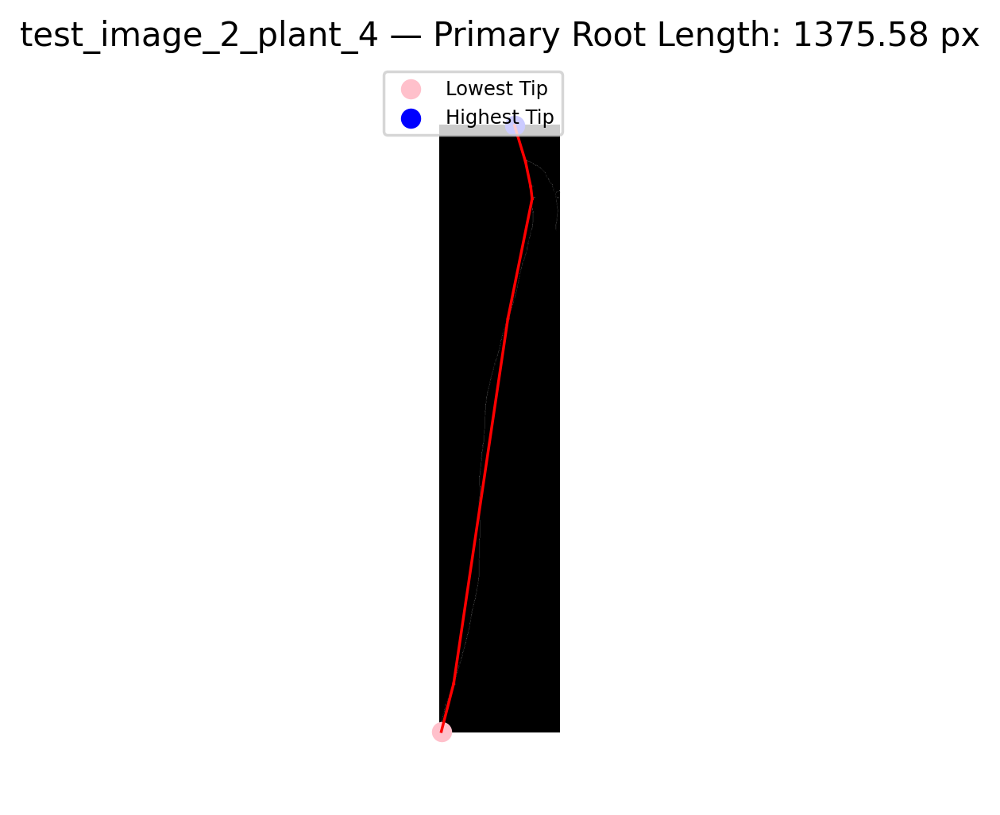

Primary root length: 1375.58 pixels
Start tip: [1275    4]
End tip: [  0 158]

test_image_2_plant_5


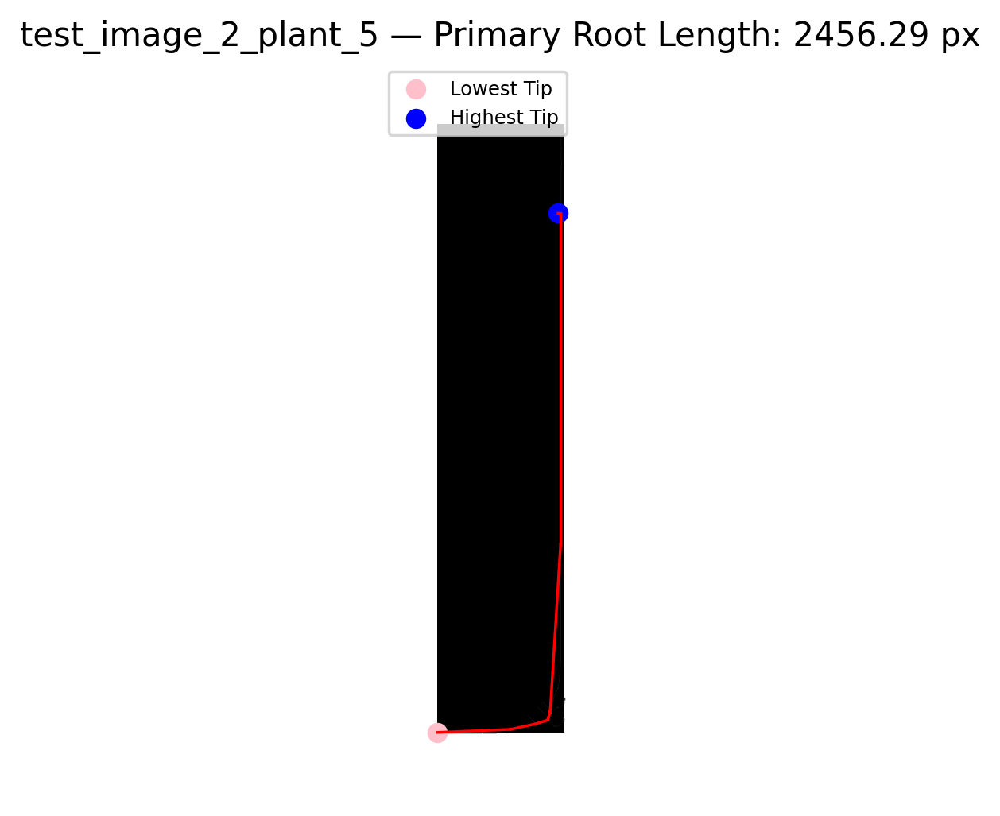

Primary root length: 2456.29 pixels
Start tip: [2362    1]
End tip: [345 470]

test_image_3_plant_1


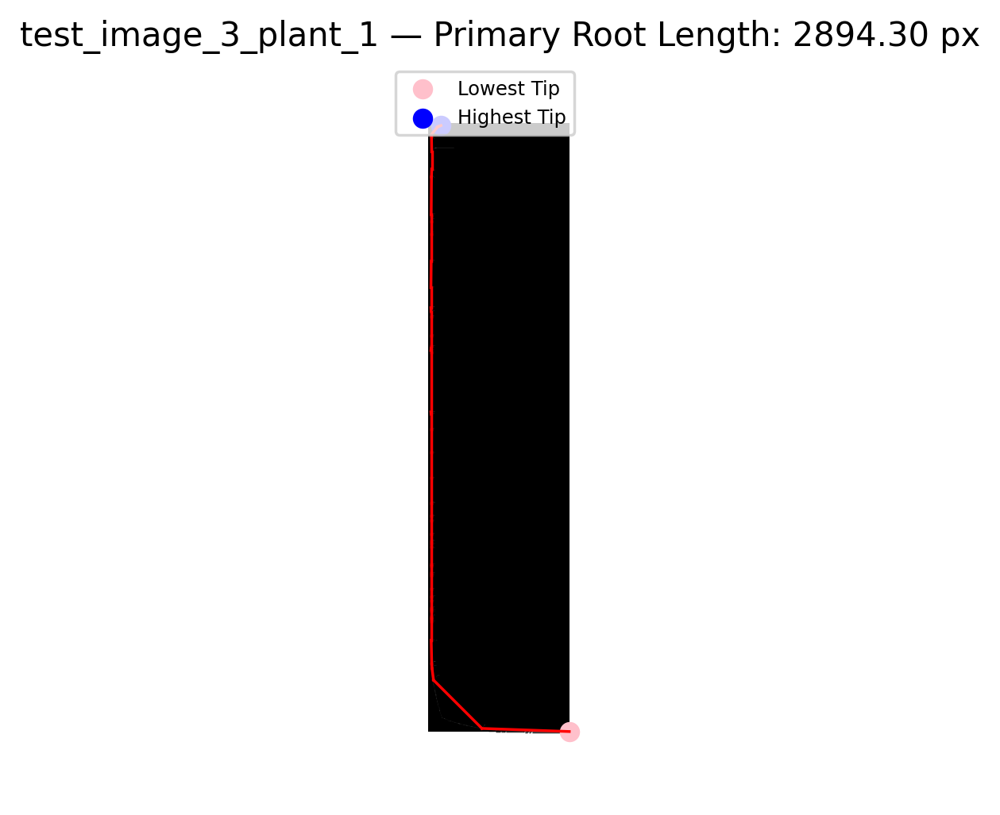

Primary root length: 2894.30 pixels
Start tip: [2361  547]
End tip: [ 6 49]

test_image_3_plant_2


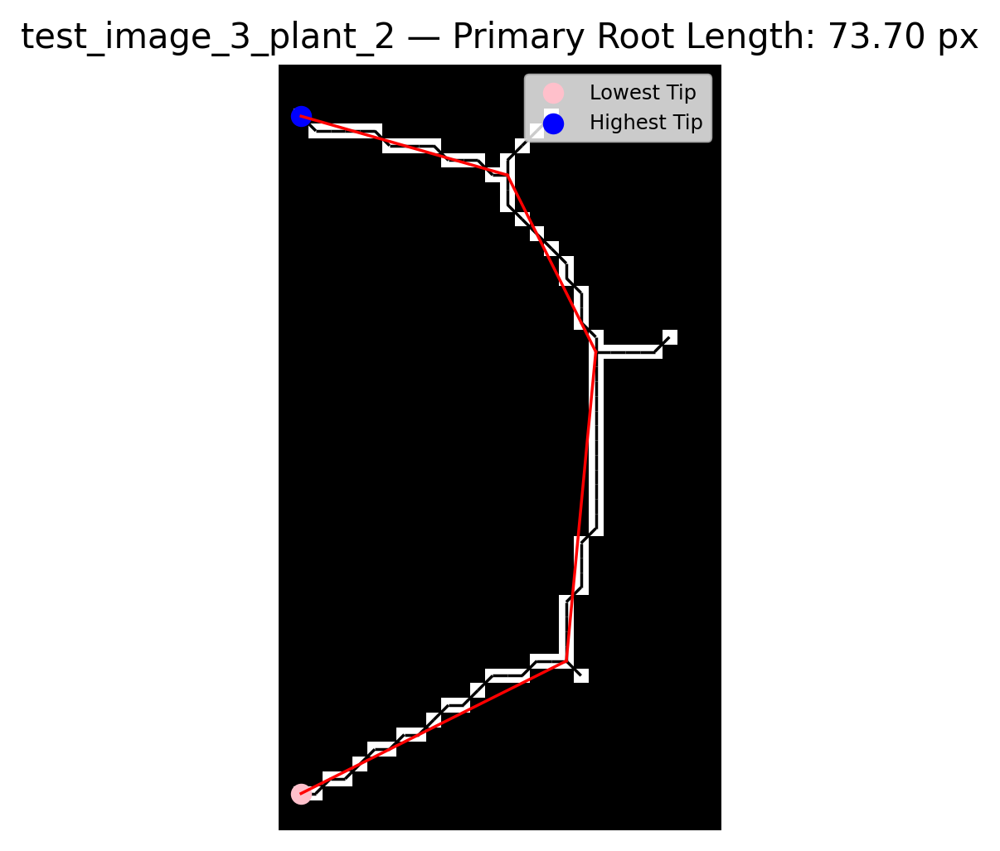

Primary root length: 73.70 pixels
Start tip: [49  1]
End tip: [3 1]

test_image_3_plant_3
No components found.

test_image_3_plant_4


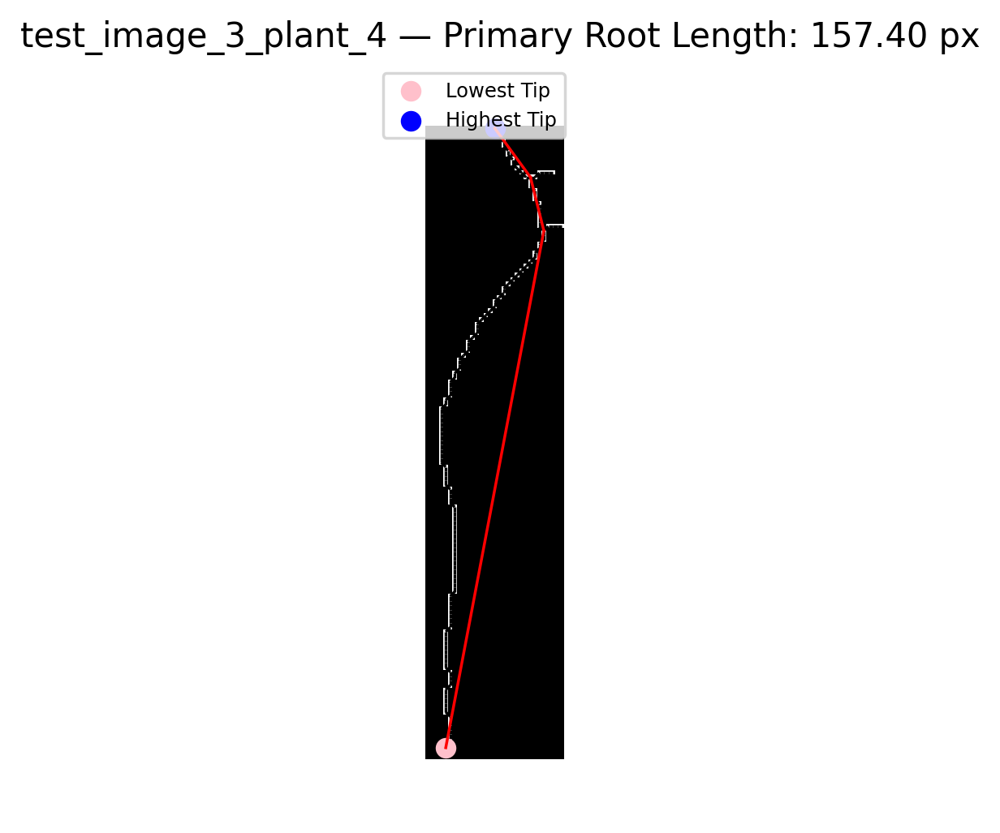

Primary root length: 157.40 pixels
Start tip: [139   4]
End tip: [ 0 15]

test_image_3_plant_5


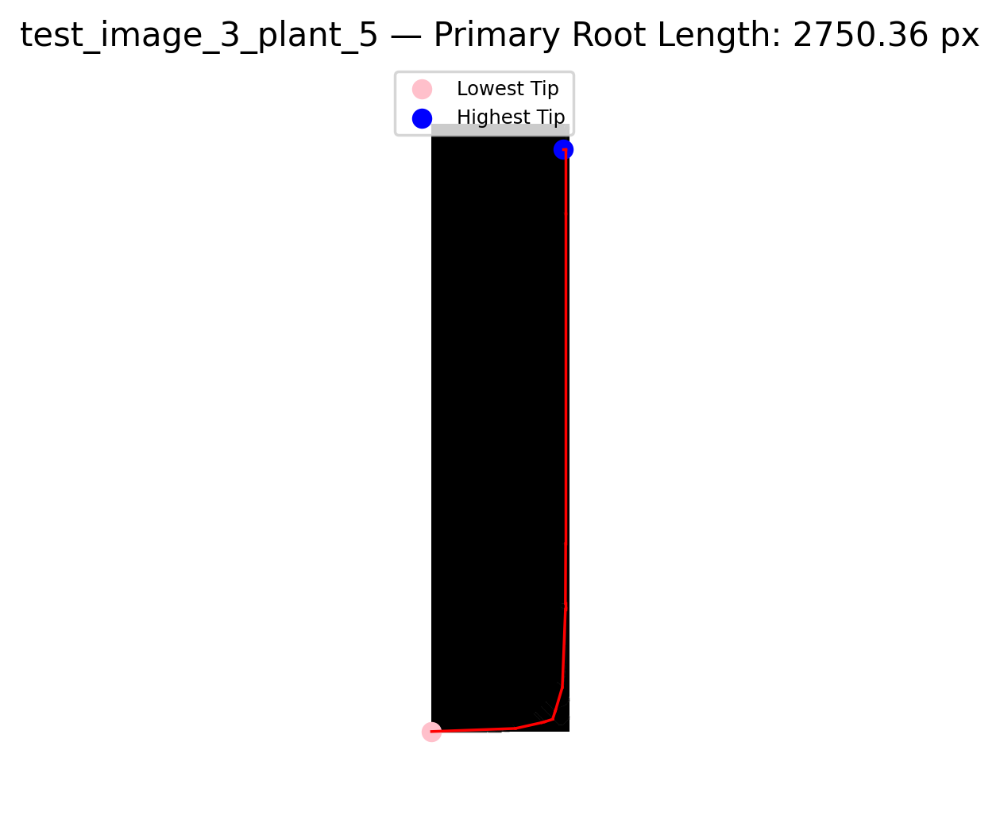

Primary root length: 2750.36 pixels
Start tip: [2362    1]
End tip: [ 96 512]

test_image_4_plant_1


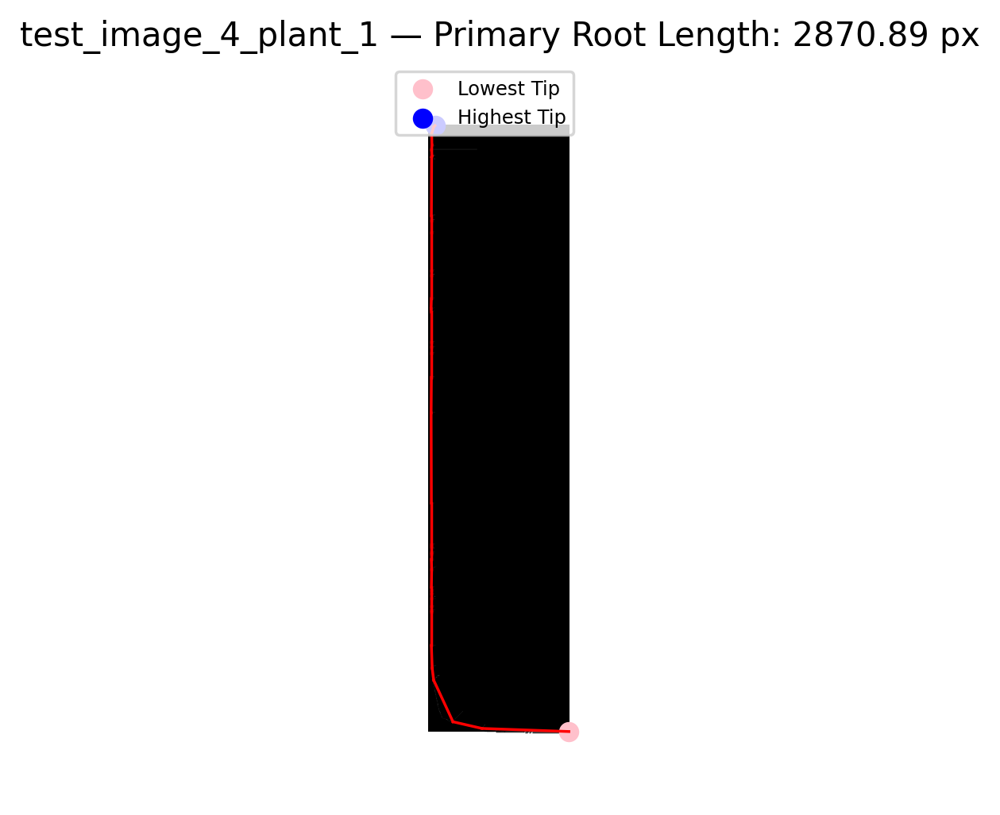

Primary root length: 2870.89 pixels
Start tip: [2361  546]
End tip: [ 1 25]

test_image_4_plant_2


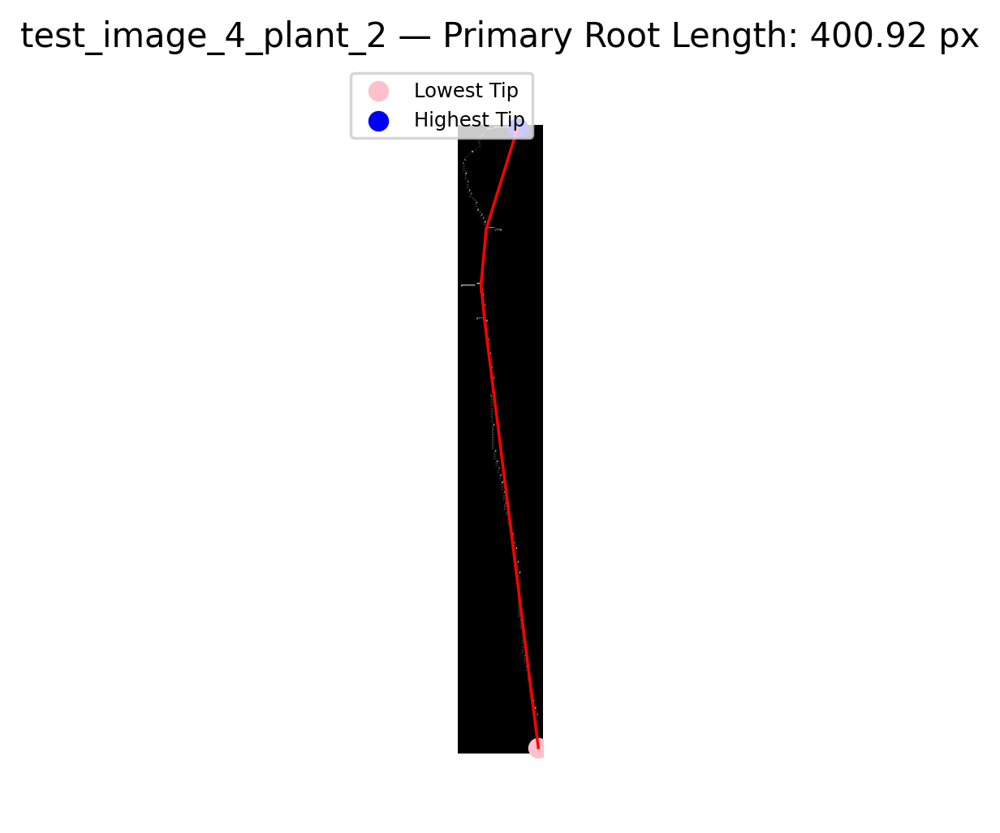

Primary root length: 400.92 pixels
Start tip: [358  46]
End tip: [ 1 34]

test_image_4_plant_3


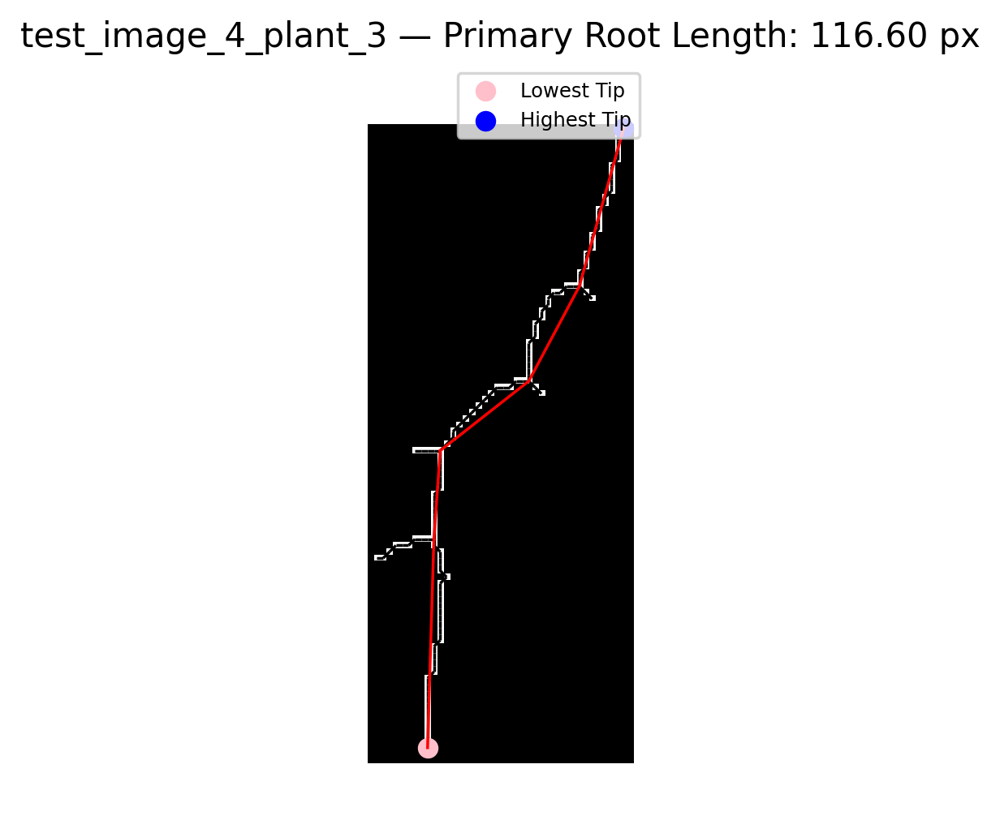

Primary root length: 116.60 pixels
Start tip: [98  9]
End tip: [ 0 40]

test_image_4_plant_4


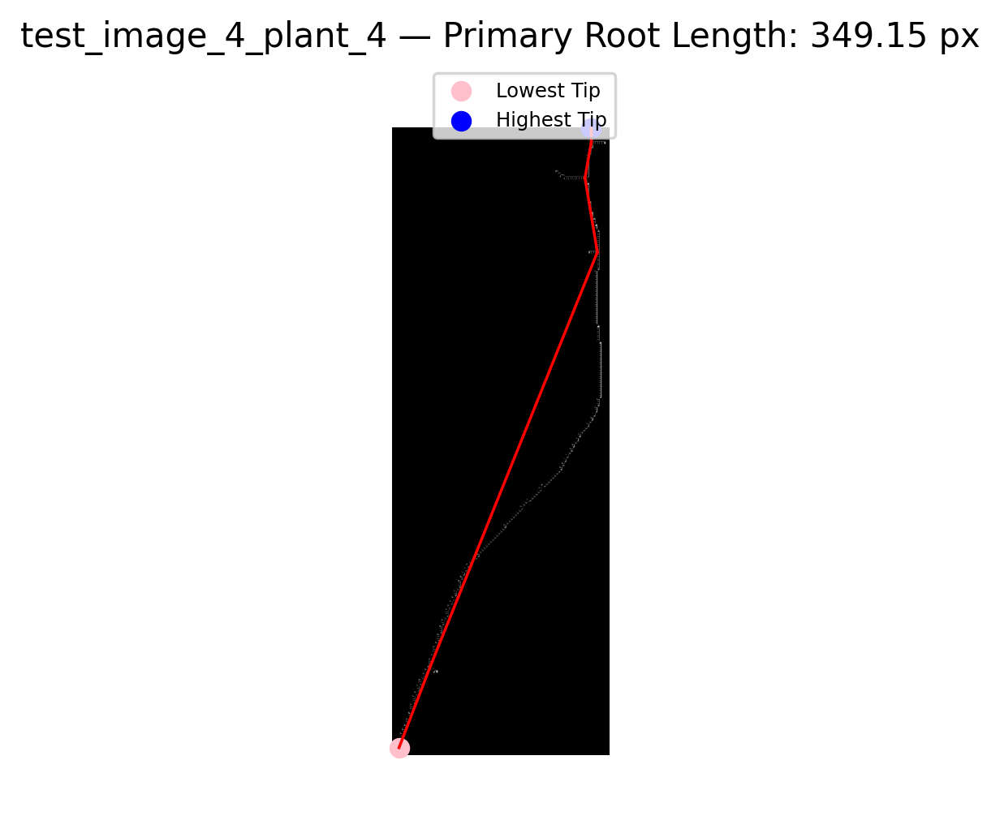

Primary root length: 349.15 pixels
Start tip: [300   3]
End tip: [ 0 96]

test_image_4_plant_5


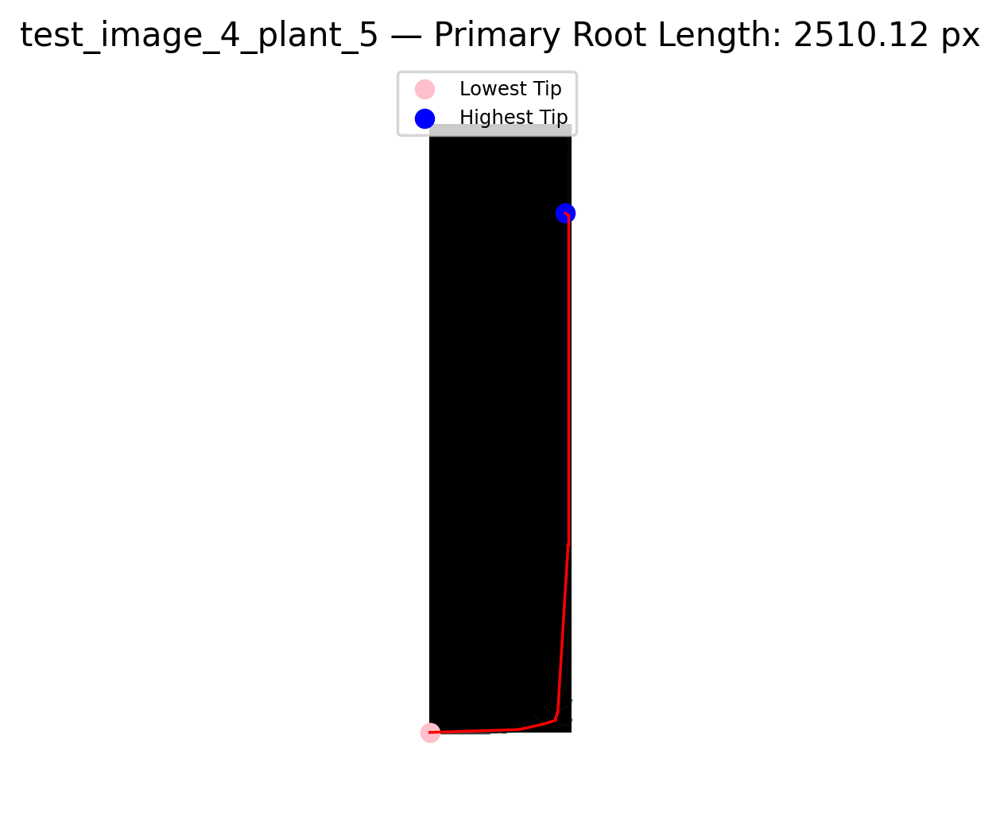

Primary root length: 2510.12 pixels
Start tip: [2361    0]
End tip: [345 527]

test_image_5_plant_1


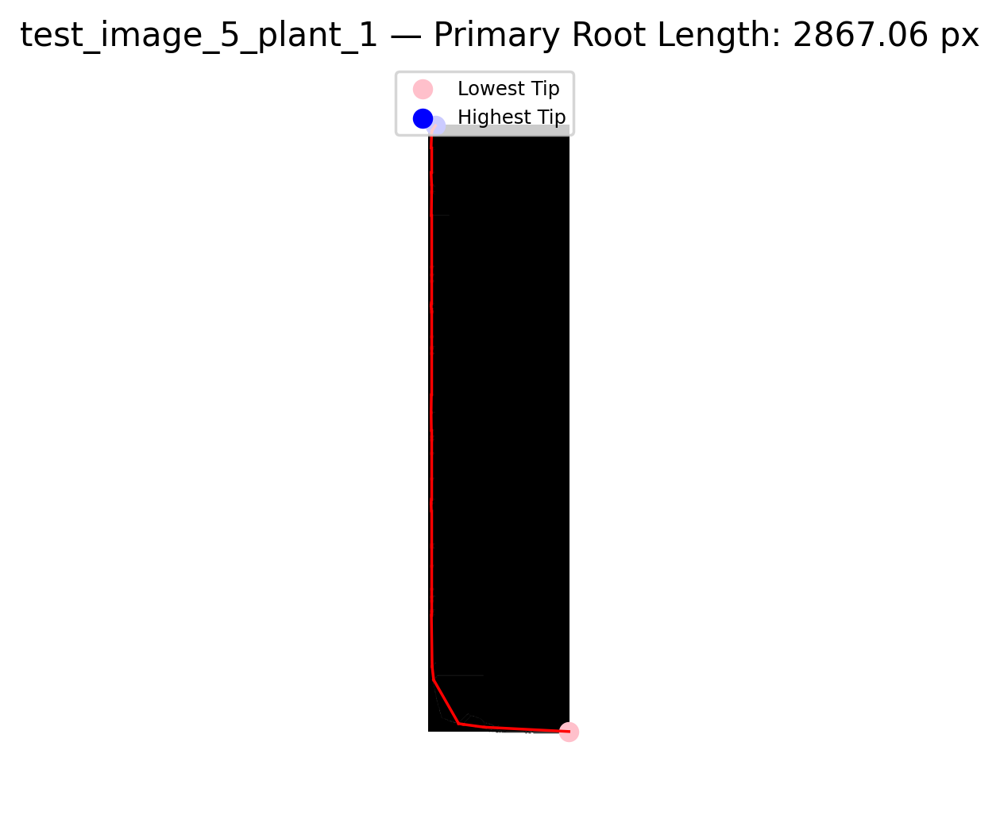

Primary root length: 2867.06 pixels
Start tip: [2361  546]
End tip: [ 2 27]

test_image_5_plant_2


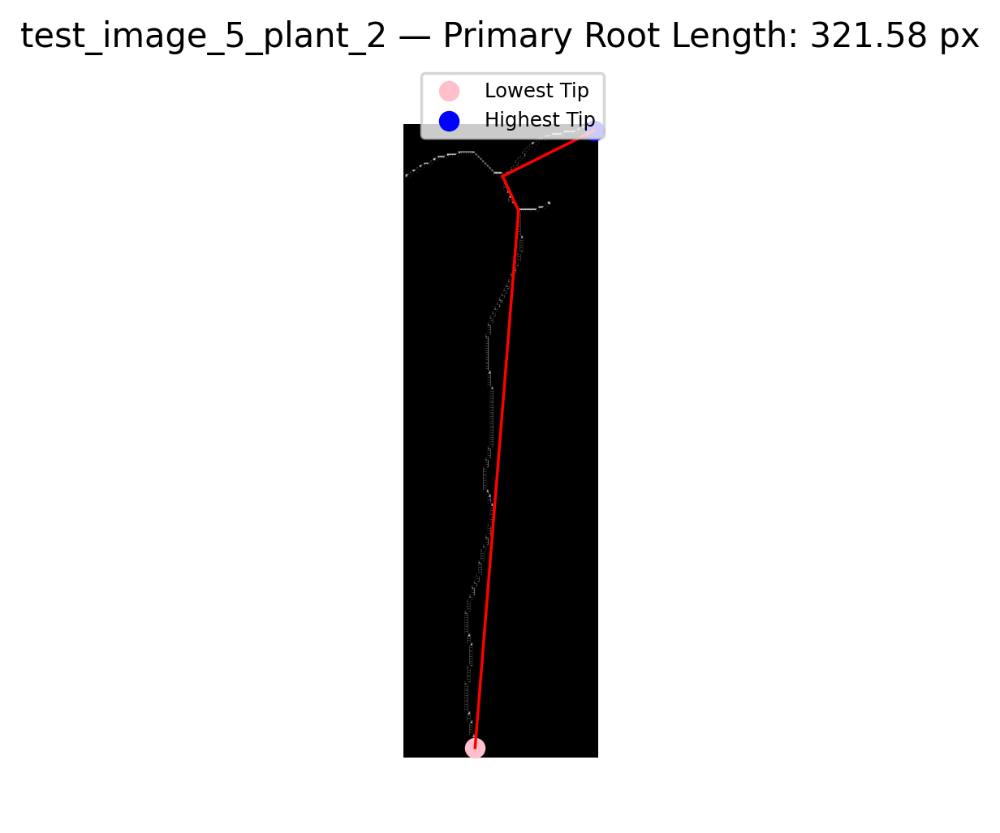

Primary root length: 321.58 pixels
Start tip: [272  31]
End tip: [ 2 83]

test_image_5_plant_3


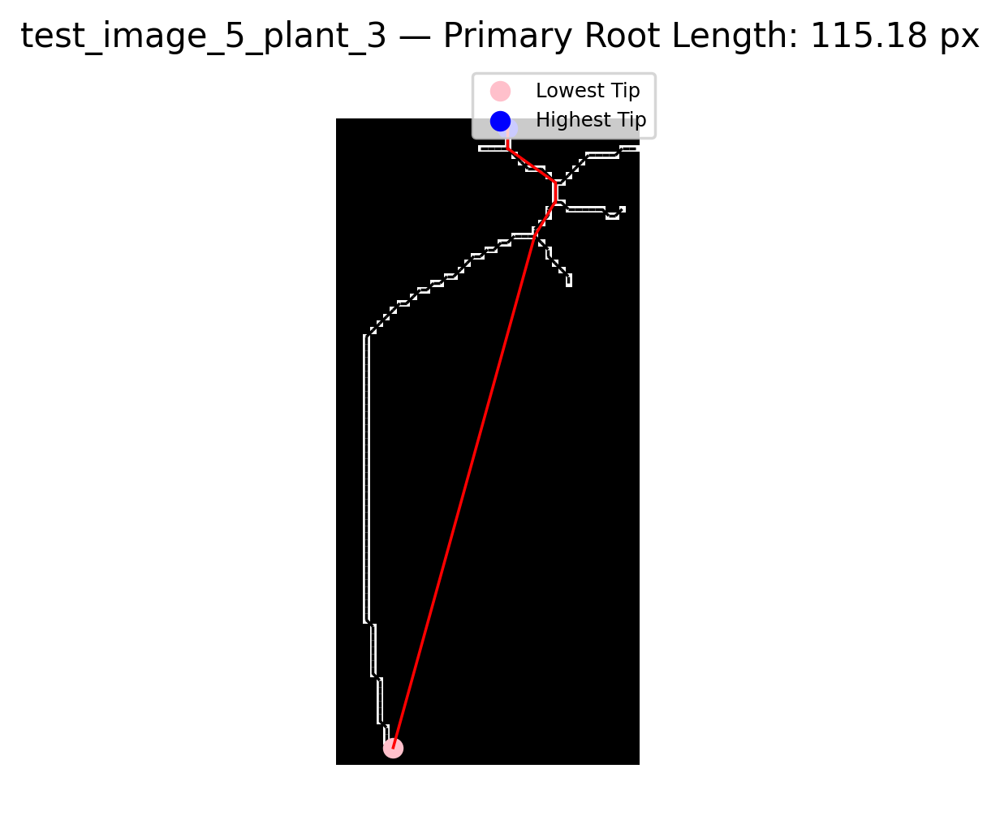

Primary root length: 115.18 pixels
Start tip: [93  8]
End tip: [ 1 25]

test_image_5_plant_4


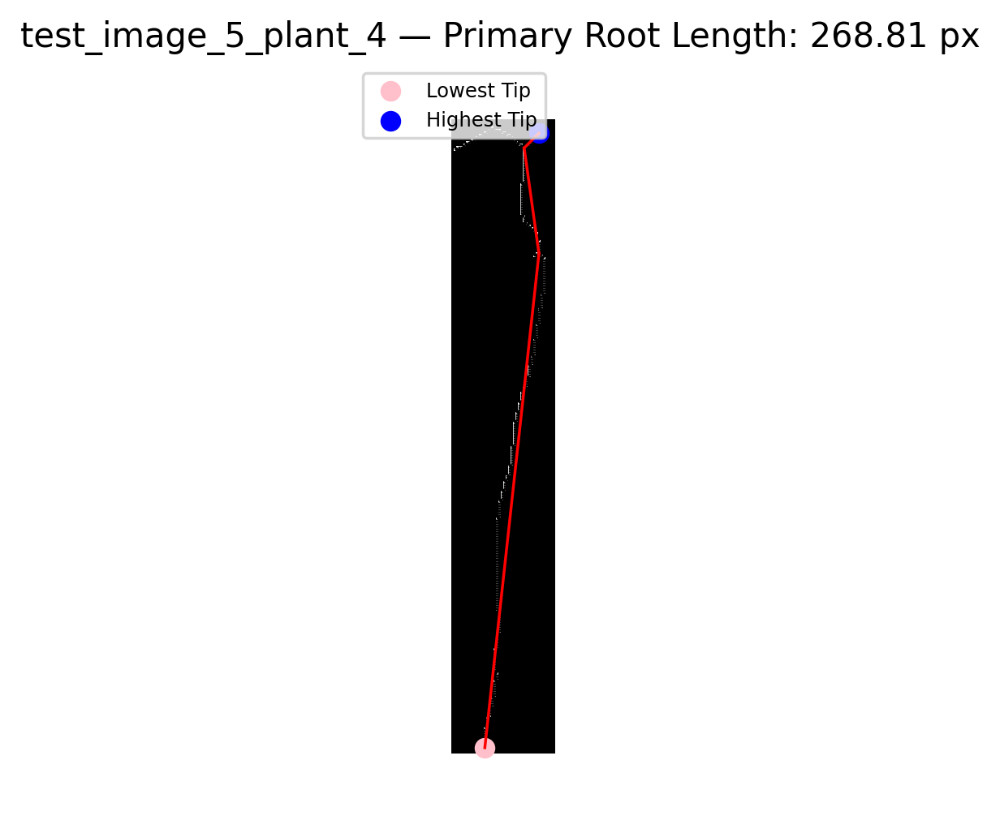

Primary root length: 268.81 pixels
Start tip: [255  13]
End tip: [ 5 35]

test_image_5_plant_5


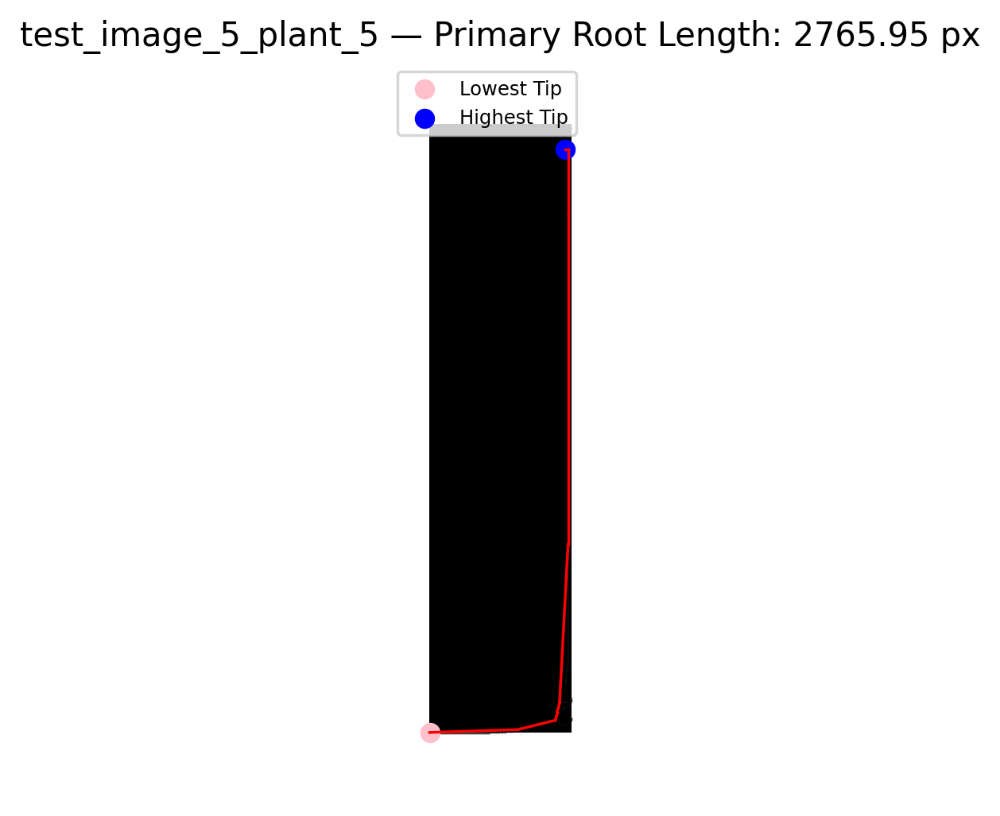

Primary root length: 2765.95 pixels
Start tip: [2361    0]
End tip: [ 96 527]

test_image_6_plant_1


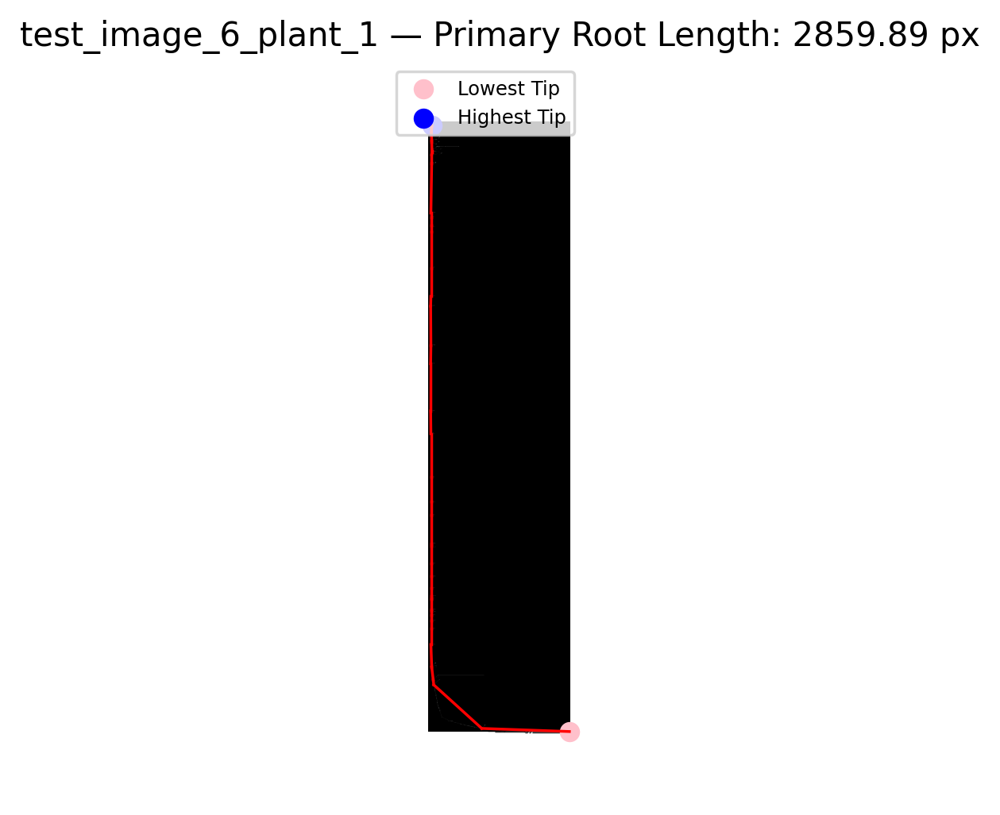

Primary root length: 2859.89 pixels
Start tip: [2361  547]
End tip: [13 15]

test_image_6_plant_2


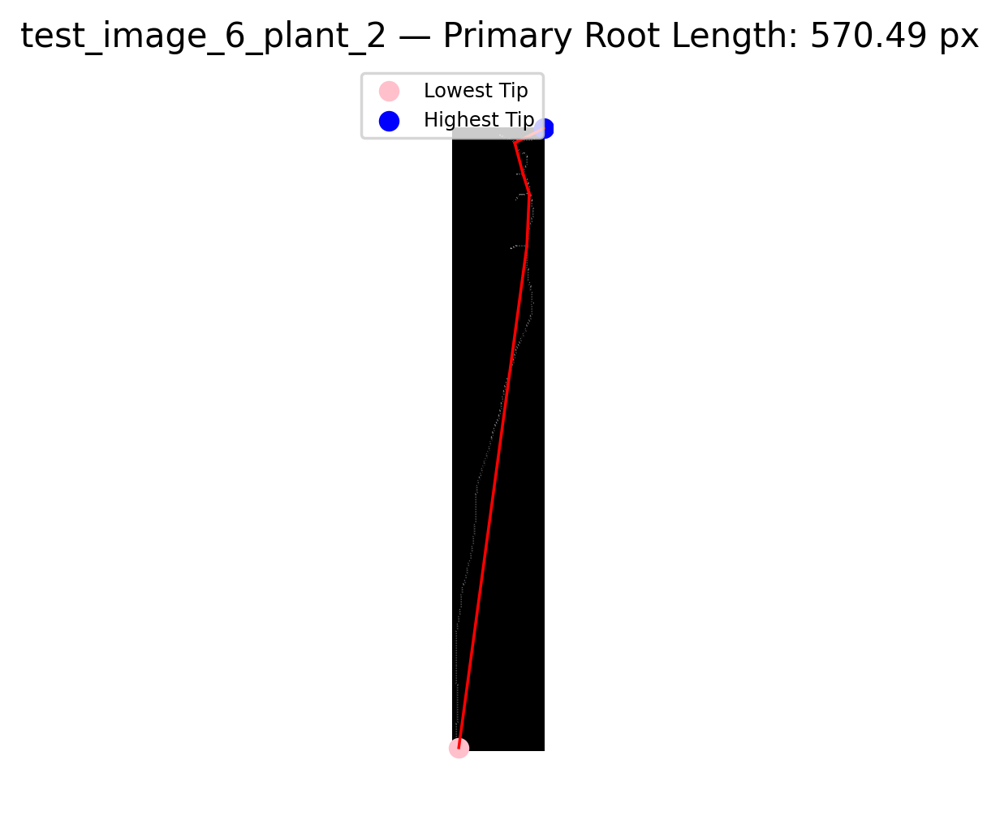

Primary root length: 570.49 pixels
Start tip: [510   5]
End tip: [ 0 75]

test_image_6_plant_3


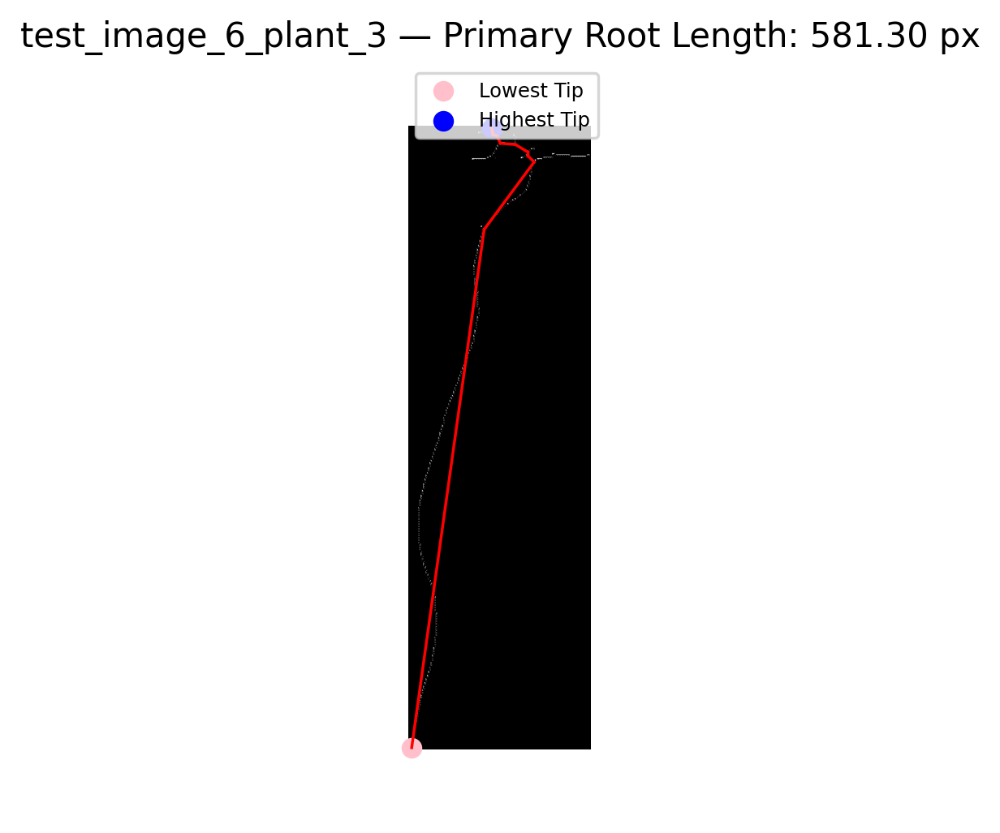

Primary root length: 581.30 pixels
Start tip: [497   2]
End tip: [ 1 66]

test_image_6_plant_4


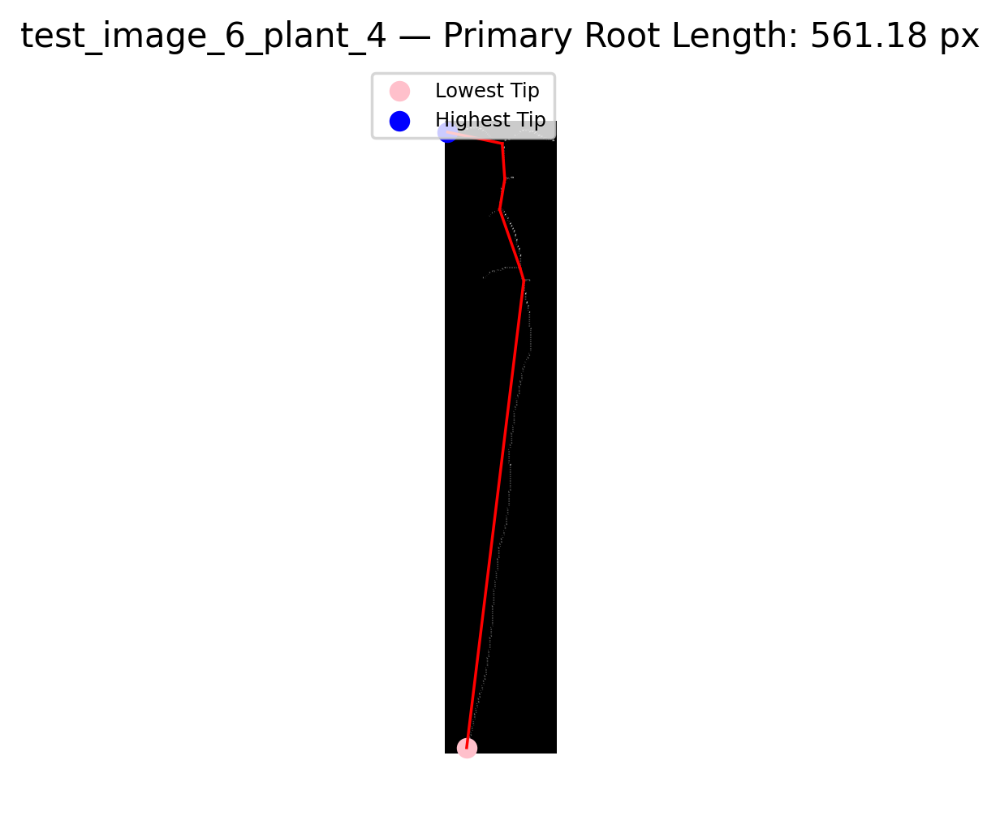

Primary root length: 561.18 pixels
Start tip: [493  17]
End tip: [8 2]

test_image_6_plant_5


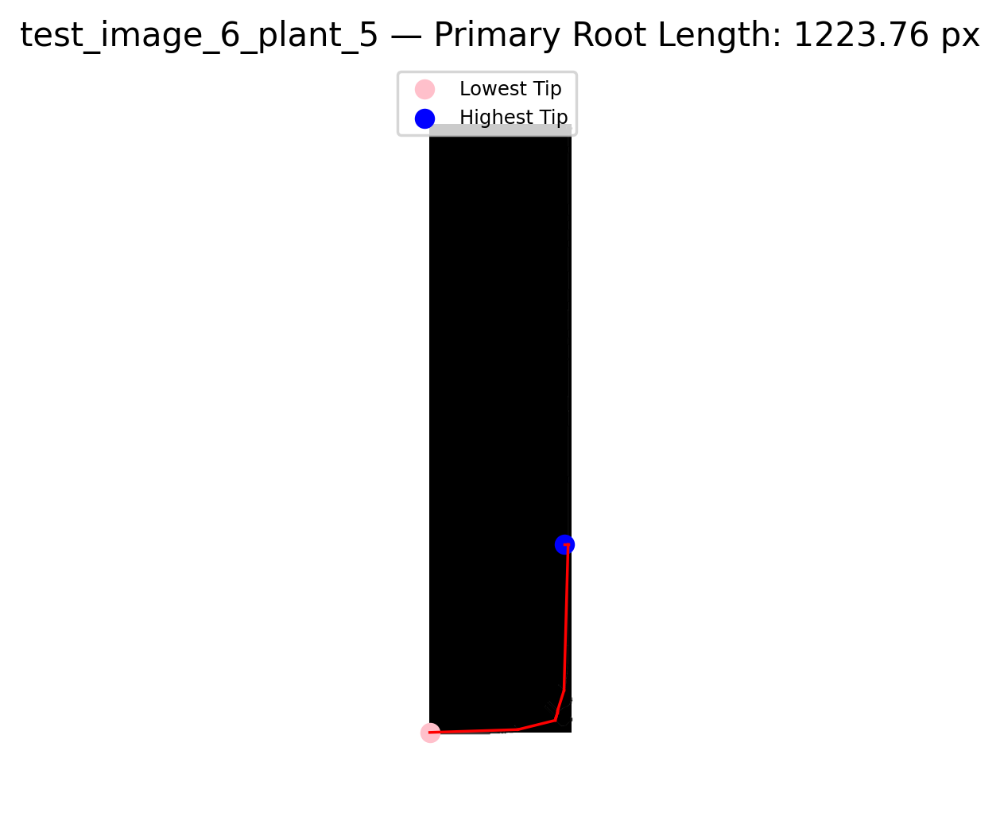

Primary root length: 1223.76 pixels
Start tip: [2361    0]
End tip: [1631  524]

test_image_7_plant_1


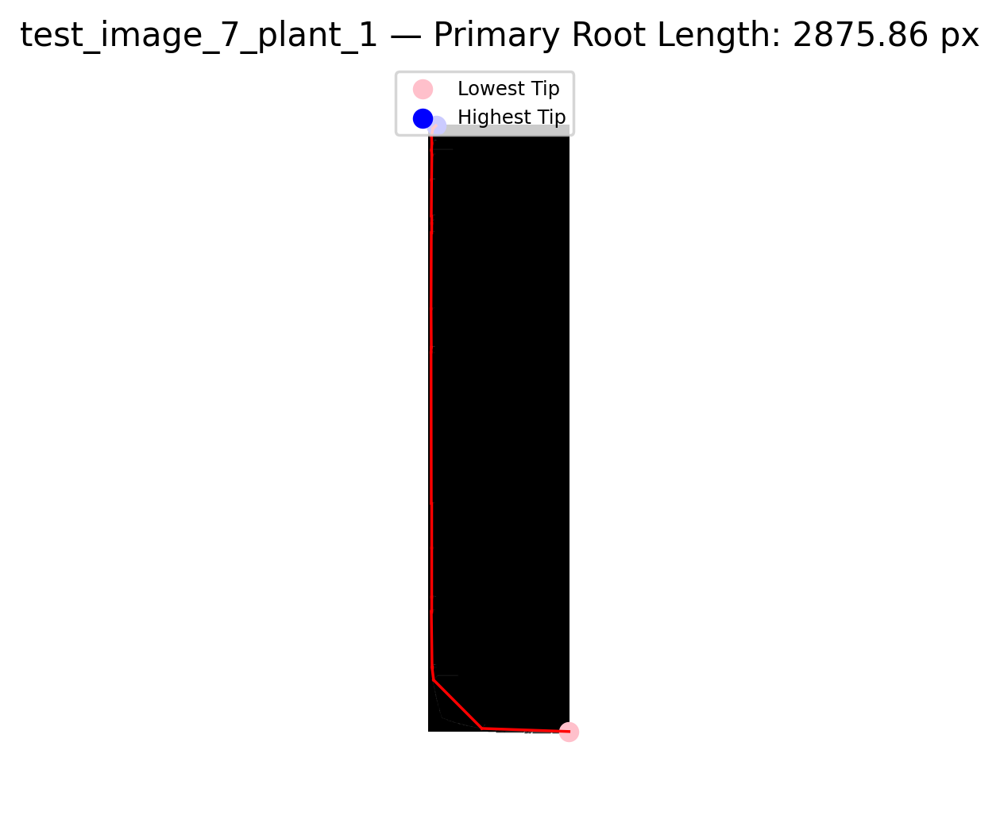

Primary root length: 2875.86 pixels
Start tip: [2361  547]
End tip: [ 0 29]

test_image_7_plant_2


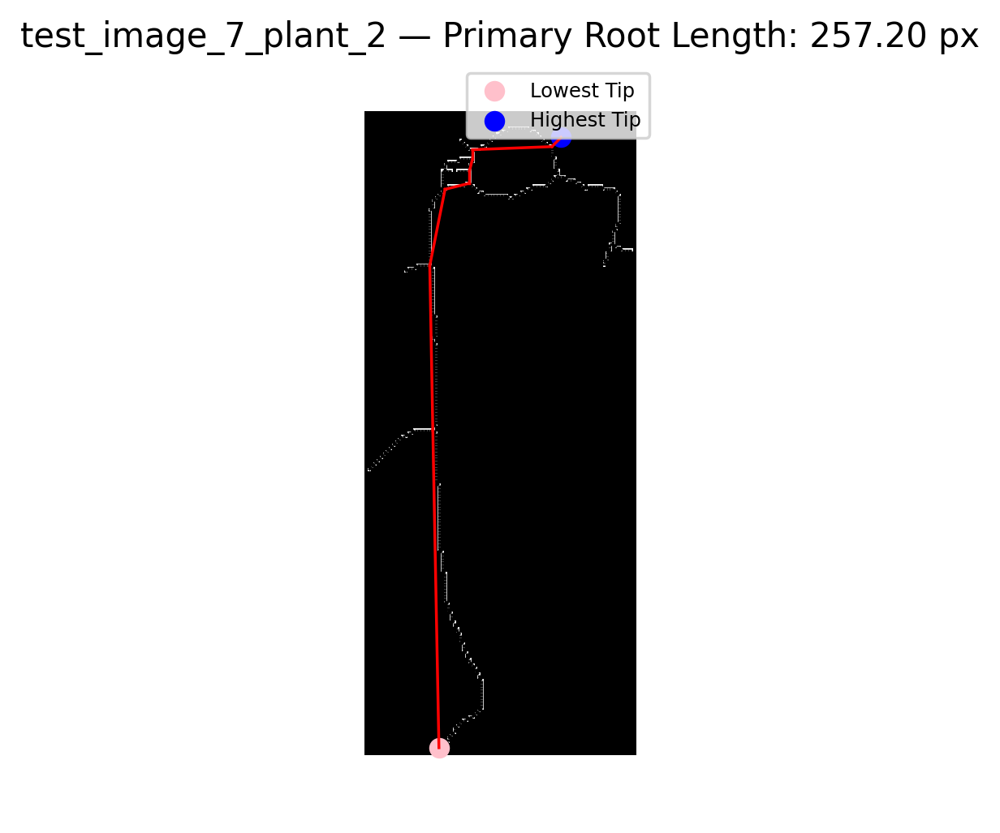

Primary root length: 257.20 pixels
Start tip: [208  24]
End tip: [ 8 64]

test_image_7_plant_3
No components found.

test_image_7_plant_4


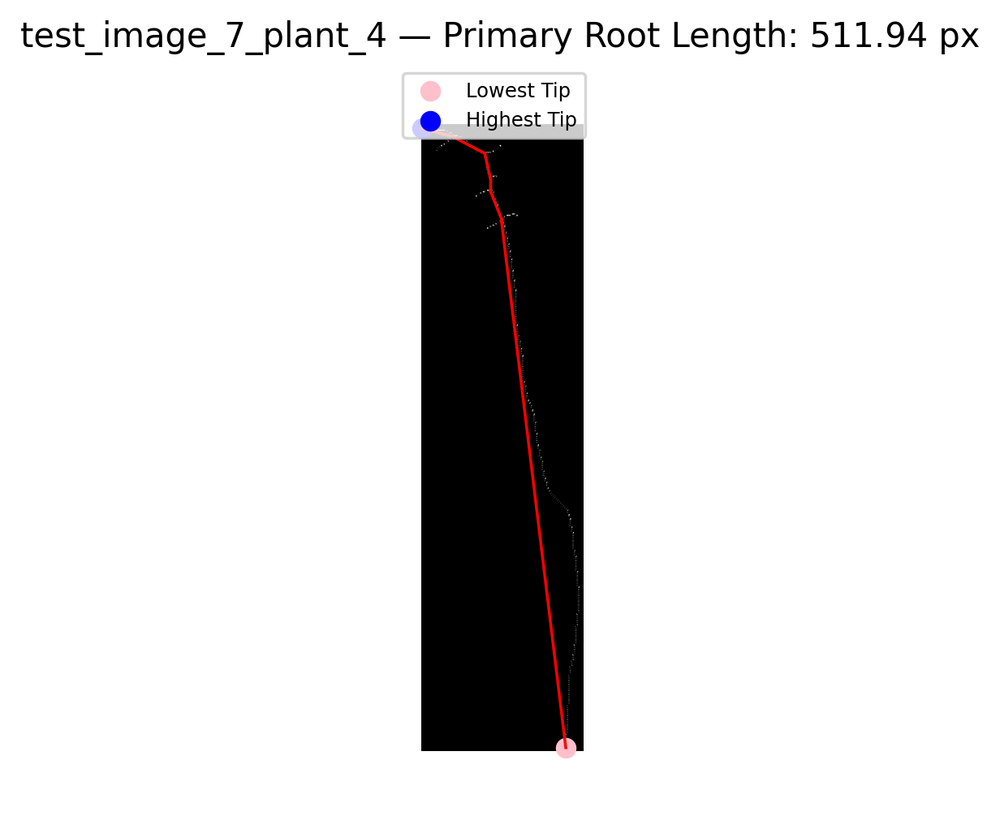

Primary root length: 511.94 pixels
Start tip: [446 103]
End tip: [2 0]

test_image_7_plant_5


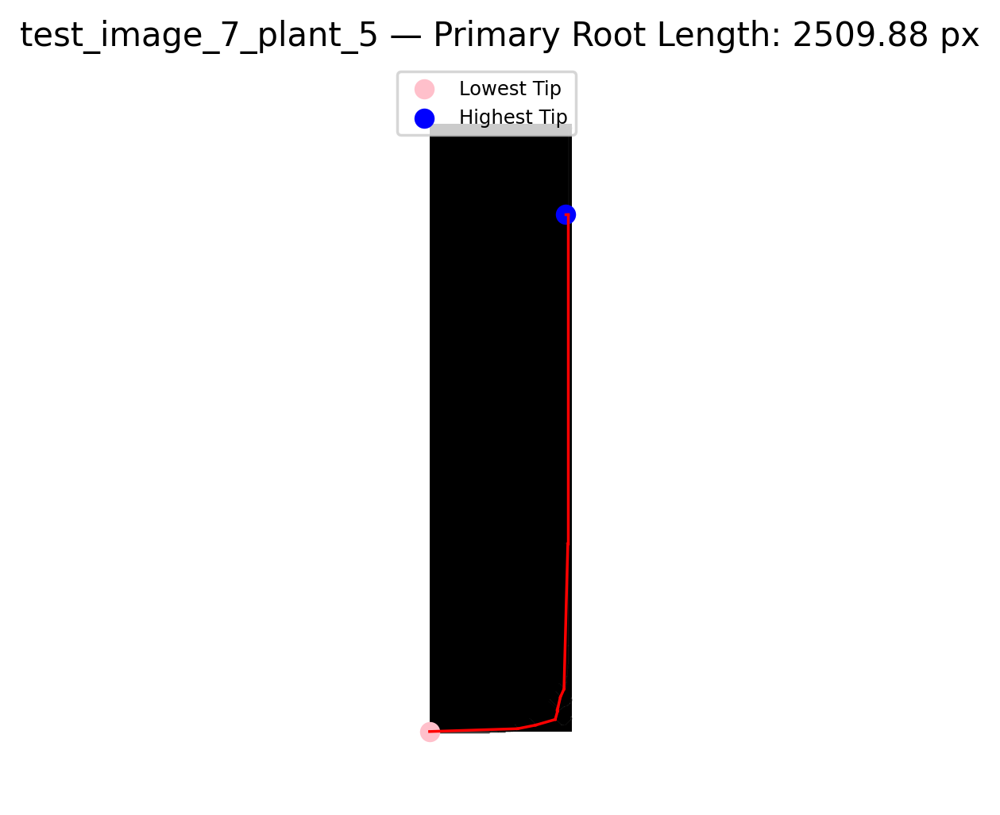

Primary root length: 2509.88 pixels
Start tip: [2361    0]
End tip: [351 527]

test_image_8_plant_1


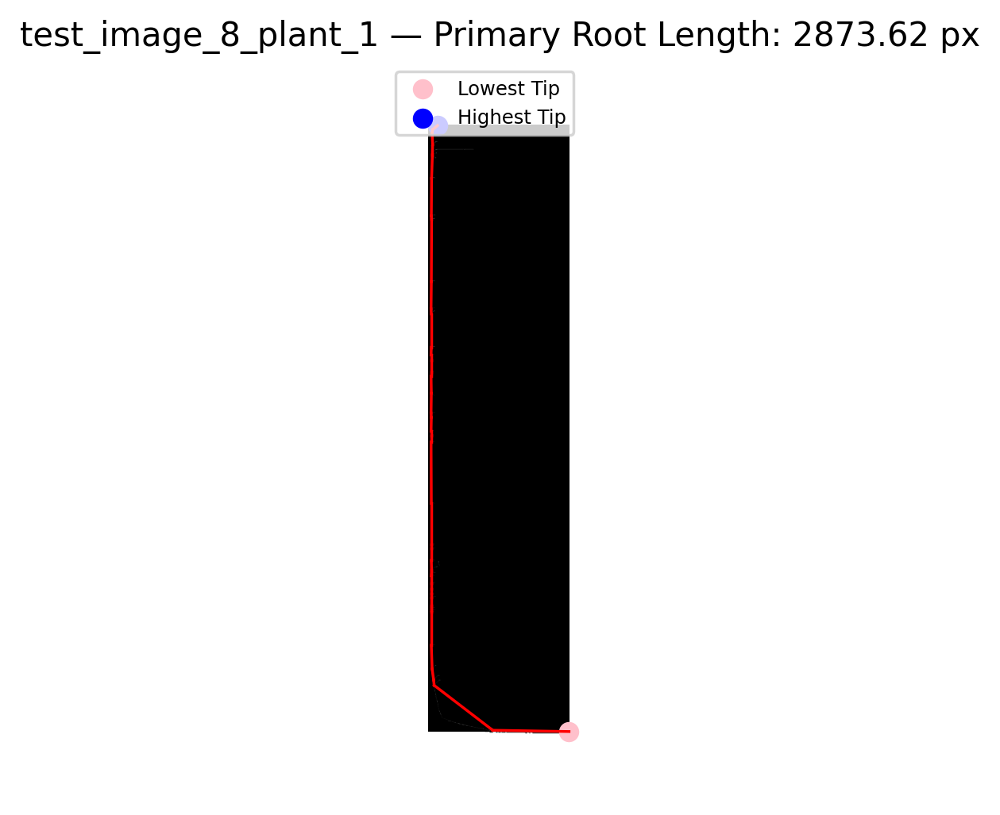

Primary root length: 2873.62 pixels
Start tip: [2361  547]
End tip: [ 0 35]

test_image_8_plant_2


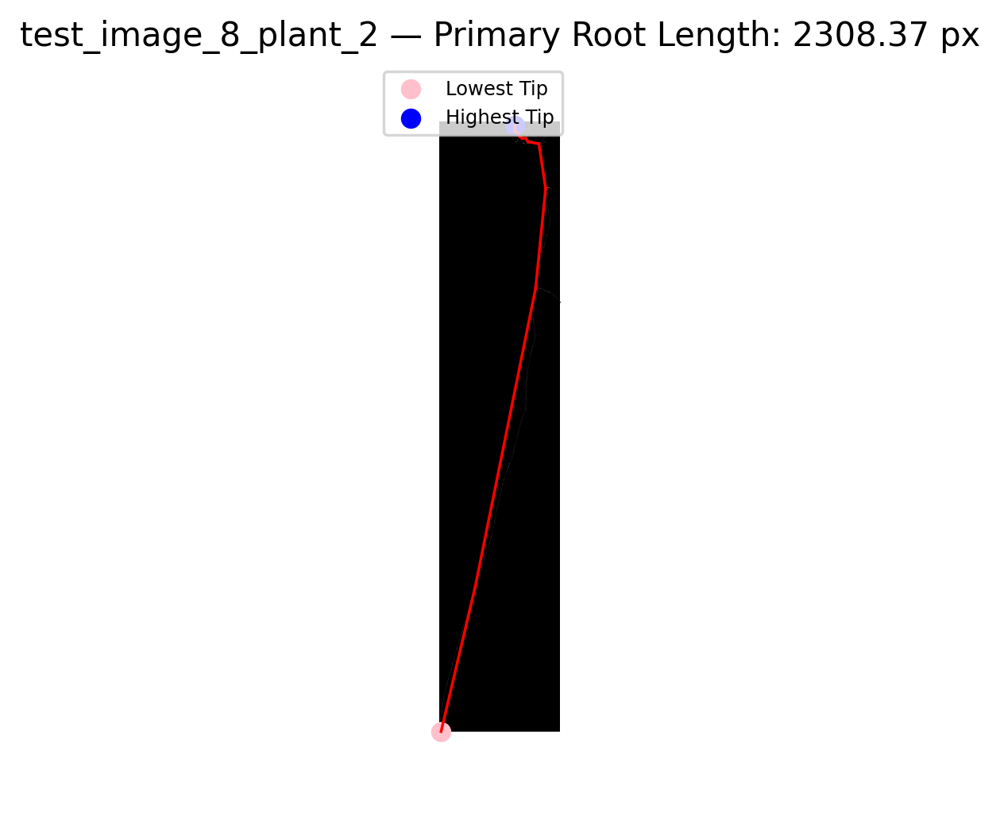

Primary root length: 2308.37 pixels
Start tip: [2075    5]
End tip: [ 10 257]

test_image_8_plant_3


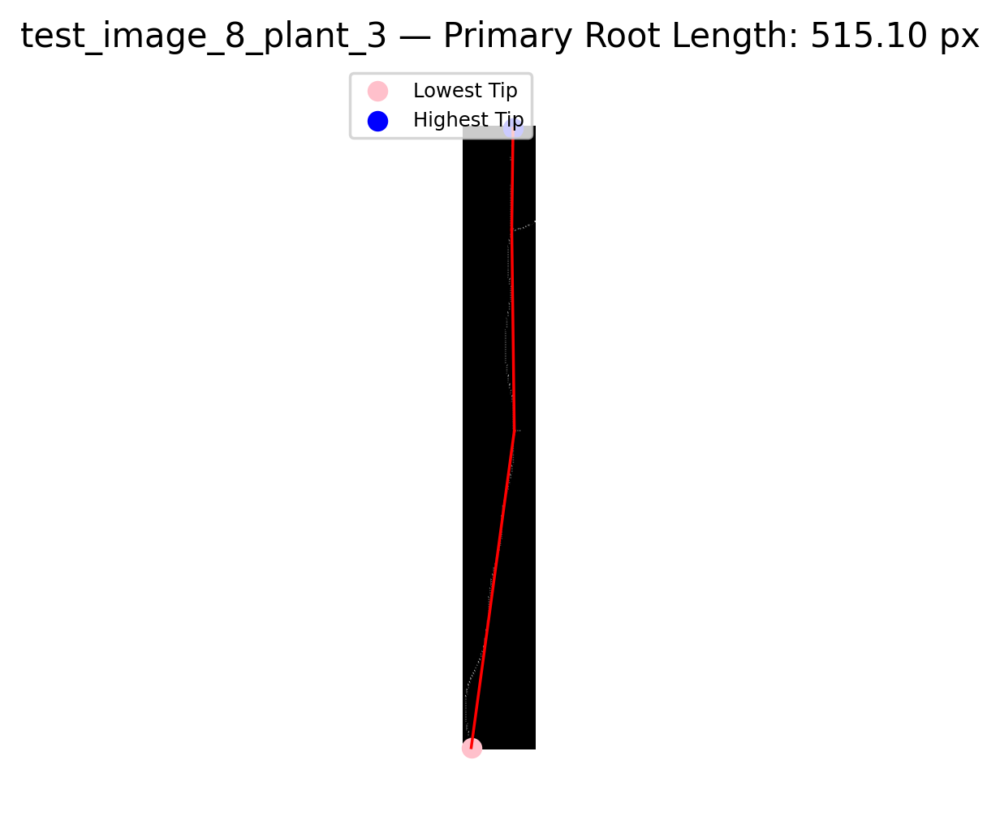

Primary root length: 515.10 pixels
Start tip: [490   6]
End tip: [ 1 39]

test_image_8_plant_4


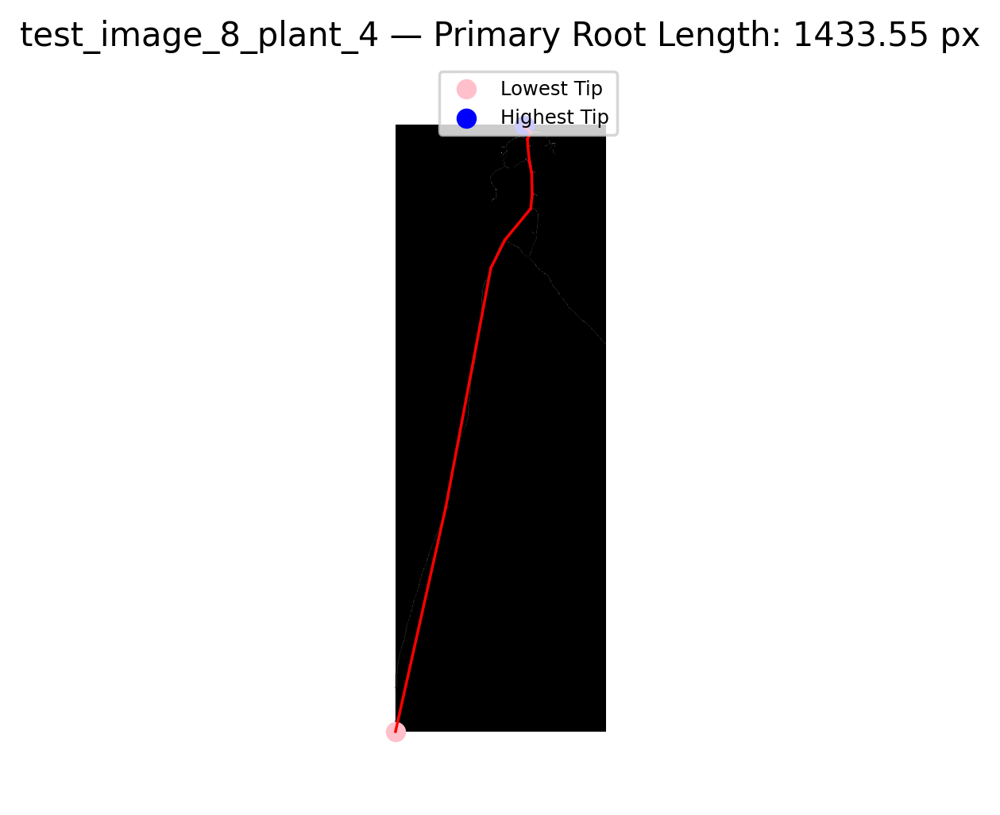

Primary root length: 1433.55 pixels
Start tip: [1292    0]
End tip: [  0 275]

test_image_8_plant_5


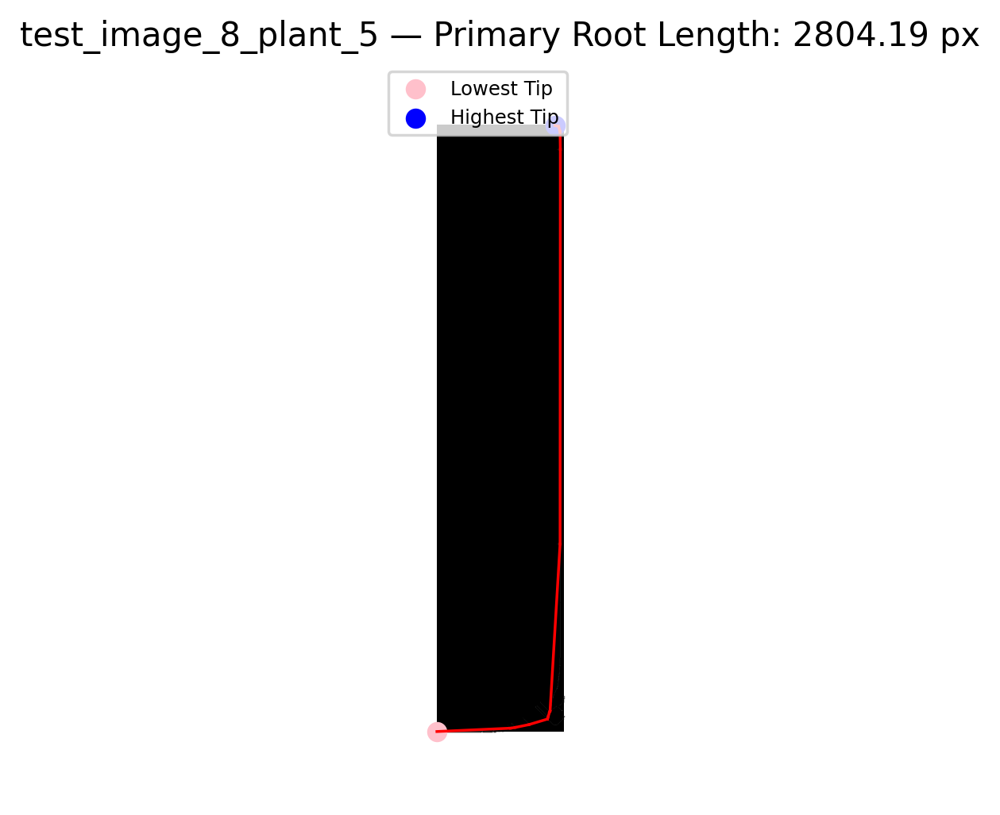

Primary root length: 2804.19 pixels
Start tip: [2362    1]
End tip: [  3 460]

test_image_9_plant_1


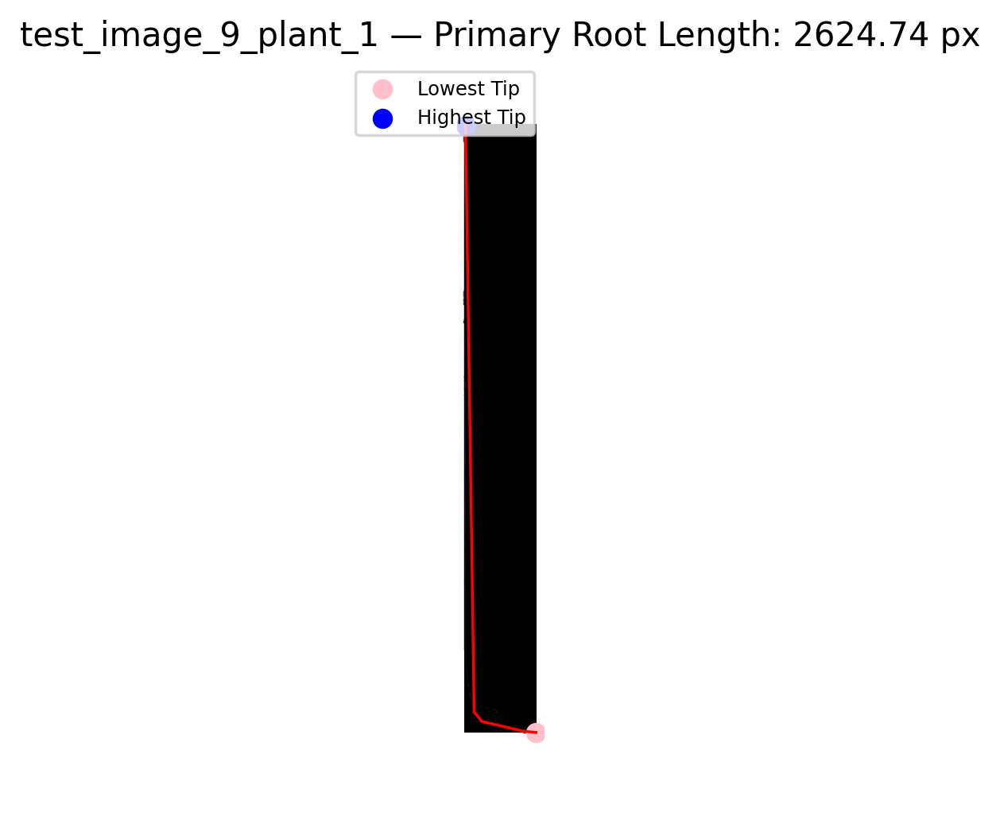

Primary root length: 2624.74 pixels
Start tip: [2390  283]
End tip: [5 6]

test_image_9_plant_2


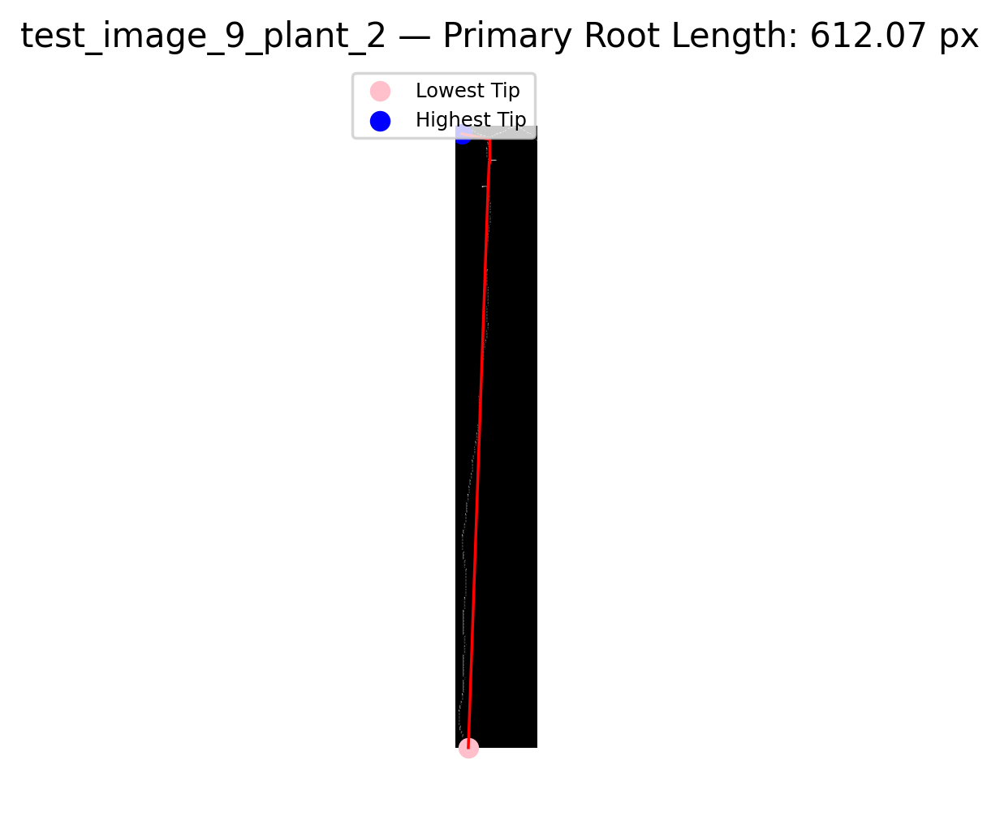

Primary root length: 612.07 pixels
Start tip: [566  11]
End tip: [6 5]

test_image_9_plant_3


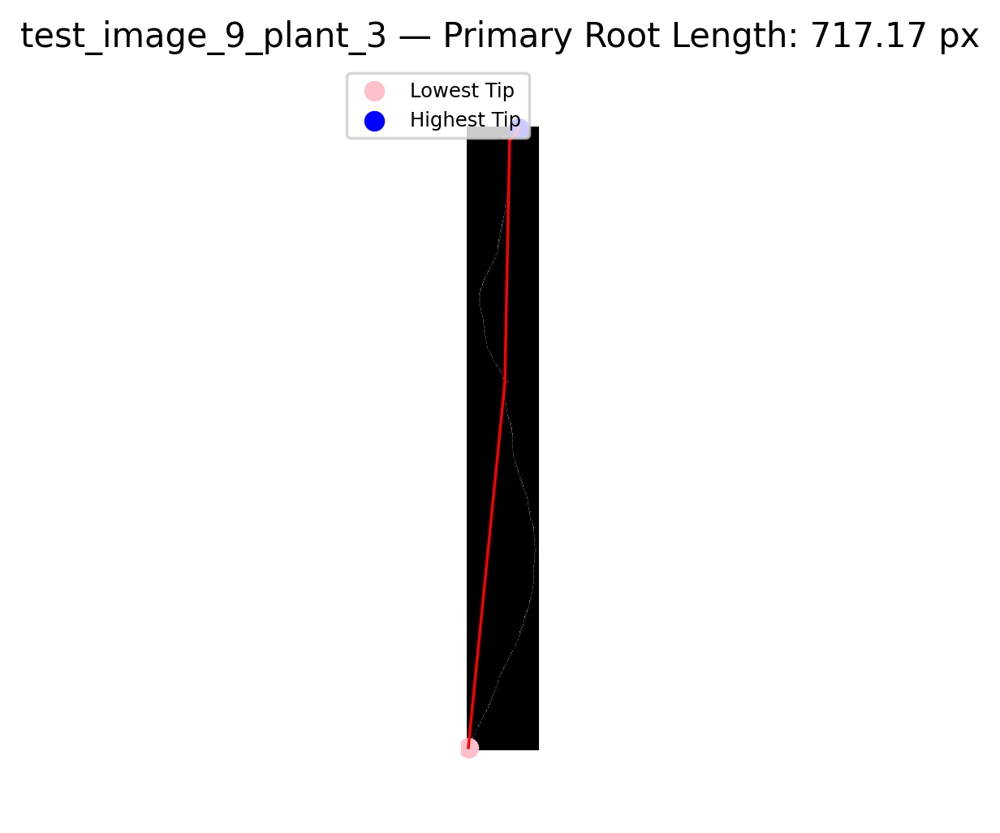

Primary root length: 717.17 pixels
Start tip: [646   1]
End tip: [ 1 53]

test_image_9_plant_4


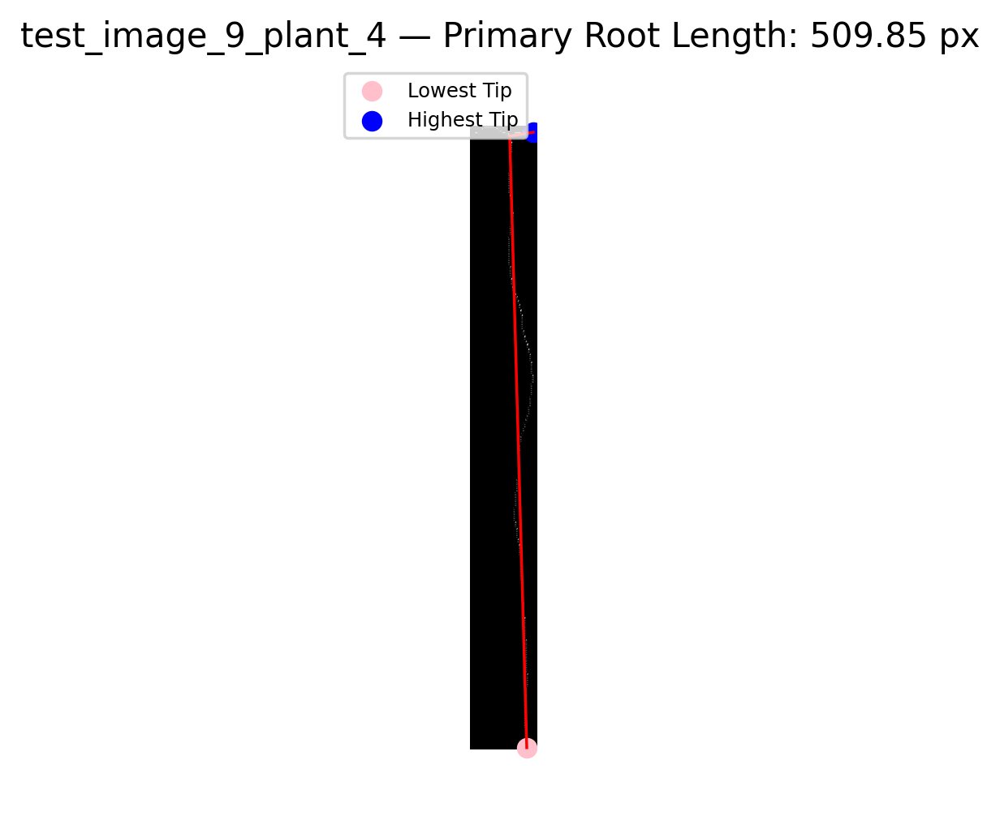

Primary root length: 509.85 pixels
Start tip: [474  43]
End tip: [ 4 48]

test_image_9_plant_5


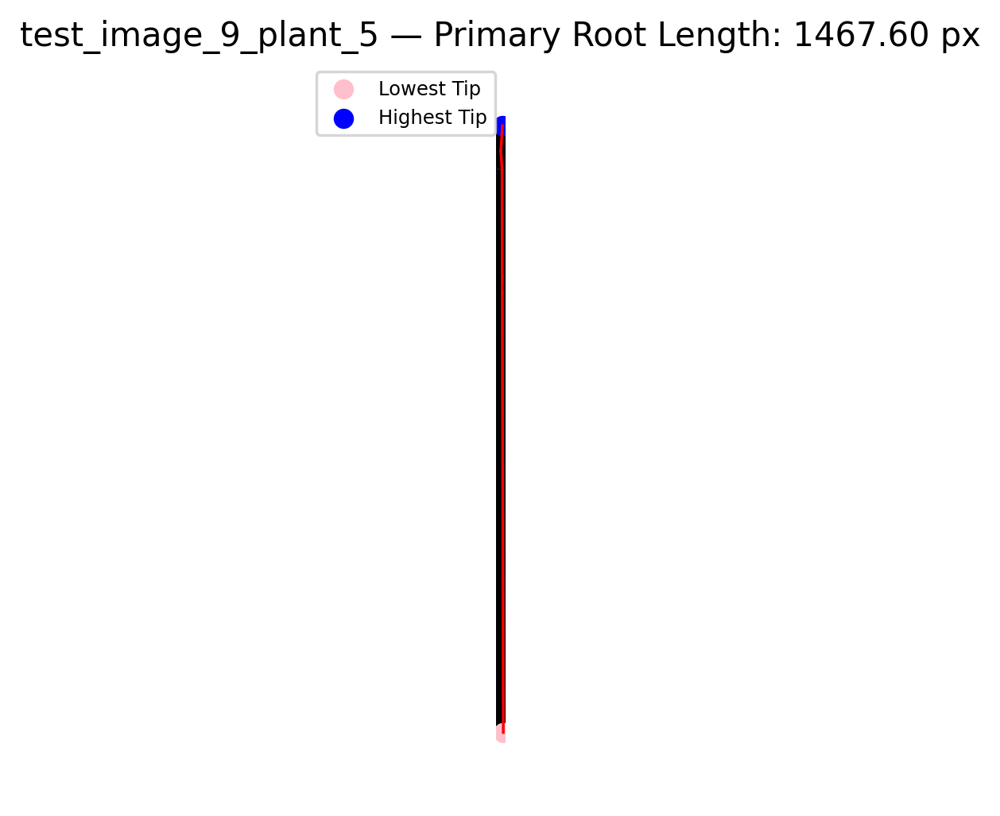

Primary root length: 1467.60 pixels
Start tip: [1459   17]
End tip: [ 3 15]


In [15]:
primary_root_lengths = {}

for name, mask in final_root_masks.items():
    print(f"\n{name}")
    
    # Ensure mask is binary
    binary = (mask > 0).astype(np.uint8)  
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(binary, connectivity=8)  # Label connected regions

    if num_labels <= 1:
        primary_root_lengths[name] = 0  # No root found
        print("No components found.")
        continue

    # Get largest non-background component
    largest_component = np.argmax(stats[1:, cv2.CC_STAT_AREA]) + 1  

    # Create mask for largest root
    component_mask = (labels == largest_component).astype(np.uint8)  

    skeleton = skeletonize(component_mask)  # Convert root mask to 1-pixel skeleton

    # Crop to bounding box of the root component
    x, y, w, h, _ = stats[largest_component]
    cropped_skel = skeleton[y:y+h, x:x+w]

    # Convert skeleton to graph structure
    g0, c0 = skeleton_to_csgraph(cropped_skel)
    node_coordinates = np.transpose(c0)
    skeleton_obj = Skeleton(cropped_skel)
    branch_data = summarize(skeleton_obj)

    # Create a graph using skeleton branches as edges
    G = nx.from_pandas_edgelist(branch_data, source='node-id-src', target='node-id-dst', edge_attr='branch-distance')
    tip_nodes = [n for n, d in G.degree() if d == 1]  # Find skeleton endpoints
    tip_coords = {n: node_coordinates[n] for n in tip_nodes}

    if len(tip_coords) < 2:
        total_distance = 0  # Not enough tips to define a root path
        shortest_path = []
    else:
        # Choose lowest and highest tips (vertically) as start/end of root
        lowest_node = max(tip_coords, key=lambda n: tip_coords[n][0])
        highest_node = min(tip_coords, key=lambda n: tip_coords[n][0])

        try:
            # Compute shortest path through skeleton between root tips
            shortest_path = nx.shortest_path(G, source=lowest_node, target=highest_node, weight='branch-distance')
            total_distance = nx.shortest_path_length(G, source=lowest_node, target=highest_node, weight='branch-distance')
            path_edges = list(zip(shortest_path, shortest_path[1:]))
        except nx.NetworkXNoPath:
            shortest_path = []
            total_distance = 0  # No path found

    # Save root length (in pixels)
    primary_root_lengths[name] = round(total_distance, 2)  

    # Visualisation
    fig, ax = plt.subplots()
    draw.overlay_skeleton_networkx(g0, node_coordinates, image=cropped_skel, axis=ax, node_size=0, with_labels=False)

    if shortest_path:
        # Mark start and end tips
        ax.scatter(*tip_coords[lowest_node][::-1], color='pink', s=40, label='Lowest Tip')
        ax.scatter(*tip_coords[highest_node][::-1], color='blue', s=40, label='Highest Tip')

        # Highlight path between tips
        for u, v in path_edges:
            p1, p2 = node_coordinates[u], node_coordinates[v]
            ax.plot([p1[1], p2[1]], [p1[0], p2[0]], color='red', lw=1.0)

        ax.set_title(f"{name} — Primary Root Length: {total_distance:.2f} px")
        ax.legend(loc='upper right', fontsize=7 , frameon=True)
    else:
        ax.set_title(f"{name} — No valid path found.")

    ax.axis('off')
    fig.set_dpi(250)
    plt.show()

    # Text output
    if shortest_path:
        print(f"Primary root length: {total_distance:.2f} pixels")
        print(f"Start tip: {tip_coords[lowest_node]}")
        print(f"End tip: {tip_coords[highest_node]}")
    else:
        print("No primary root path detected.")

In [16]:
import csv

# Path to save the CSV
csv_path = "/Volumes/T7/Artificial Intelligence/YEAR 2.1/Block B retake/task8/01_submission.csv"

# Write to CSV
with open(csv_path, mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Plant ID", "Length (px)"])  # header
    for plant_id, length in primary_root_lengths.items():
        writer.writerow([plant_id, length])

print(f"Saved primary root lengths to:\n{csv_path}")

Saved primary root lengths to:
/Volumes/T7/Artificial Intelligence/YEAR 2.1/Block B retake/task8/01_submission.csv
